# Fishing Effort Globally

In [1]:
import bq  
import time
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
import matplotlib
from matplotlib import colors,colorbar
import matplotlib
%matplotlib inline
import csv 
import math
from math import radians, cos, sin, asin, sqrt
from scipy import stats
import matplotlib.dates as mdates

client = bq.Client.Get()

/Users/David/Desktop/Jobs/GlobalFishingWatch/github/vessel-maps/utilities/pipa_paper/venv/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


In [2]:
# create a bounding box:
max_lat = 80
min_lat = -80
max_lon = 180
min_lon = -180

In [3]:
def Query(q):
    t0 = time.time()
    answer = client.ReadTableRows(client.Query(q)['configuration']['query']['destinationTable'])
    print 'Query time: ' + str(time.time() - t0) + ' seconds.'
    return answer

In [4]:
q = '''
select count(*) from(
select mmsi 
FROM
  Table_Date_Range([pipeline_classify_logistic_661b_fishing.], Timestamp("2015-01-01"), Timestamp("2015-12-31"))
WHERE
  lat > '''+str(min_lat)+'''
  AND lat <'''+str(max_lat)+'''
  AND lon > '''+str(min_lon)+'''
  AND lon < '''+str(max_lon)+'''
  AND measure_new_score >=.5 group by mmsi)'''
print q

number_of_mmsi = Query(q)


select count(*) from(
select mmsi 
FROM
  Table_Date_Range([pipeline_classify_logistic_661b_fishing.], Timestamp("2015-01-01"), Timestamp("2015-12-31"))
WHERE
  lat > -80
  AND lat <80
  AND lon > -180
  AND lon < 180
  AND measure_new_score >=.5 group by mmsi)
Waiting on bqjob_r25673eb06a08a513_00000155cc5e342d_1 ... (15s) Current status: DONE   
Query time: 25.8039798737 seconds.


In [5]:
print "Number of unique MMSI:",int(number_of_mmsi[0][0])

Number of unique MMSI: 38255


In [6]:
q = '''
SELECT
  COUNT(*) from(
  SELECT
    mmsi
  FROM (
    SELECT
      mmsi,
      lat,
      lon,
      measure_new_score
    FROM
      TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31")))
  WHERE
  lat > '''+str(min_lat)+'''
  AND lat <'''+str(max_lat)+'''
  AND lon > '''+str(min_lon)+'''
  AND lon < '''+str(max_lon)+'''
    AND measure_new_score >=.5
    AND mmsi IN (
    SELECT
      INTEGER(mmsi) mmsi
    FROM
      [scratch_global_fishing_raster.classification_results_20160506]
WHERE
      max_label_label='Longliner')
  GROUP BY
    mmsi)'''
print q

number_of_mmsi = Query(q)


SELECT
  COUNT(*) from(
  SELECT
    mmsi
  FROM (
    SELECT
      mmsi,
      lat,
      lon,
      measure_new_score
    FROM
      TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31")))
  WHERE
  lat > -80
  AND lat <80
  AND lon > -180
  AND lon < 180
    AND measure_new_score >=.5
    AND mmsi IN (
    SELECT
      INTEGER(mmsi) mmsi
    FROM
      [scratch_global_fishing_raster.classification_results_20160506]
WHERE
      max_label_label='Longliner')
  GROUP BY
    mmsi)
Waiting on bqjob_r5512817e4df08ed0_00000155cc5e9903_2 ... (16s) Current status: DONE   
Query time: 20.670623064 seconds.


In [7]:
print "Number of unique MMSI:",int(number_of_mmsi[0][0])

Number of unique MMSI: 2845


# 525 Longliers were fishing in this region in 2015

In [8]:
# Find number of fishing days by mmsi. 

q = '''
SELECT
    a.mmsi mmsi,
    a.number_days_fishing number_days_fishing,
    IF(b.country IS NULL, "invalid mmsi",b.country) country,
    b.continent continent
  FROM (
    SELECT
      mmsi,
      INTEGER(IF(LENGTH(STRING(mmsi))= 9,LEFT(STRING(mmsi),3), '0')) code,
      COUNT(*) number_days_fishing
    FROM (
      SELECT
        mmsi,
        DATE(timestamp) date,
--         FIRST(lat) lat,
--         FIRST(lon) lon
      FROM
        TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31"))
      WHERE
  lat > '''+str(min_lat)+'''
  AND lat <'''+str(max_lat)+'''
  AND lon > '''+str(min_lon)+'''
  AND lon < '''+str(max_lon)+'''
        AND measure_new_score >=.5
      GROUP BY
        mmsi,
        date)
    GROUP BY
      mmsi,
      code ) a
  LEFT JOIN
    [scratch_roan.country_code] b
  ON
    a.code = b.code
  ORDER BY
    number_days_fishing DESC'''
print q
days_by_mmsi = Query(q)


SELECT
    a.mmsi mmsi,
    a.number_days_fishing number_days_fishing,
    IF(b.country IS NULL, "invalid mmsi",b.country) country,
    b.continent continent
  FROM (
    SELECT
      mmsi,
      INTEGER(IF(LENGTH(STRING(mmsi))= 9,LEFT(STRING(mmsi),3), '0')) code,
      COUNT(*) number_days_fishing
    FROM (
      SELECT
        mmsi,
        DATE(timestamp) date,
--         FIRST(lat) lat,
--         FIRST(lon) lon
      FROM
        TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31"))
      WHERE
  lat > -80
  AND lat <80
  AND lon > -180
  AND lon < 180
        AND measure_new_score >=.5
      GROUP BY
        mmsi,
        date)
    GROUP BY
      mmsi,
      code ) a
  LEFT JOIN
    [scratch_roan.country_code] b
  ON
    a.code = b.code
  ORDER BY
    number_days_fishing DESC
Waiting on bqjob_r6f524e09bff4a2e4_00000155cc5ee9cc_3 ... (24s) Current status: DONE   
Query time: 33.6995201111 seconds.


# The List of MMSI that were fishing are below

In [9]:
for r in days_by_mmsi:
    if "Taiwan" in r[2]:
        r[2] = "Taiwan"
    print "mmsi:", r[0],"  fishing days:", r[1], "  country: ", r[2].split(" (")[0]

mmsi: 412331032   fishing days: 351   country:  China
mmsi: 412331031   fishing days: 348   country:  China
mmsi: 440100000   fishing days: 345   country:  Korea
mmsi: 316004170   fishing days: 343   country:  Canada
mmsi: 440987000   fishing days: 342   country:  Korea
mmsi: 432463000   fishing days: 342   country:  Japan
mmsi: 273332880   fishing days: 341   country:  Russian Federation
mmsi: 412420197   fishing days: 340   country:  China
mmsi: 231009000   fishing days: 336   country:  Faroe Islands - Denmark
mmsi: 273347730   fishing days: 336   country:  Russian Federation
mmsi: 440612000   fishing days: 336   country:  Korea
mmsi: 228148700   fishing days: 335   country:  France
mmsi: 331155000   fishing days: 335   country:  Greenland - Denmark
mmsi: 440654000   fishing days: 334   country:  Korea
mmsi: 258052000   fishing days: 333   country:  Norway
mmsi: 440807000   fishing days: 333   country:  Korea
mmsi: 432444000   fishing days: 333   country:  Japan
mmsi: 251047110   fis

In [10]:
# Now Group by Country
q = '''
SELECT
    IF(b.country IS NULL, "invalid mmsi",b.country) country,
     integer(sum(a.hours)) hours,
  FROM (
    SELECT
      mmsi,
      INTEGER(IF(LENGTH(STRING(mmsi))= 9,LEFT(STRING(mmsi),3), '0')) code,
      sum(hours) hours
    FROM (
      SELECT
        mmsi,
        sum(hours) hours,
      FROM
        TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31"))
      WHERE
       lat > '''+str(min_lat)+'''
       AND lat <'''+str(max_lat)+'''
       AND lon > '''+str(min_lon)+'''
       AND lon < '''+str(max_lon)+'''
        AND measure_new_score >=.5
      GROUP BY
        mmsi)
    GROUP BY
      mmsi,
      code ) a
  LEFT JOIN
    [scratch_roan.country_code] b
  ON
    a.code = b.code
  group by country
  ORDER BY
    hours DESC'''
print q

country_groups = Query(q)


SELECT
    IF(b.country IS NULL, "invalid mmsi",b.country) country,
     integer(sum(a.hours)) hours,
  FROM (
    SELECT
      mmsi,
      INTEGER(IF(LENGTH(STRING(mmsi))= 9,LEFT(STRING(mmsi),3), '0')) code,
      sum(hours) hours
    FROM (
      SELECT
        mmsi,
        sum(hours) hours,
      FROM
        TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31"))
      WHERE
       lat > -80
       AND lat <80
       AND lon > -180
       AND lon < 180
        AND measure_new_score >=.5
      GROUP BY
        mmsi)
    GROUP BY
      mmsi,
      code ) a
  LEFT JOIN
    [scratch_roan.country_code] b
  ON
    a.code = b.code
  group by country
  ORDER BY
    hours DESC
Waiting on bqjob_r257bdbe93527123a_00000155cc5f723d_4 ... (15s) Current status: DONE   
Query time: 20.741645813 seconds.


In [11]:
print "fishing hours\tcountry"
for c in country_groups:
    print c[1],'\t', c[0].split(" (")[0]

fishing hours	country
12437172 	China
2106780 	Spain
2065807 	Italy
1873700 	invalid mmsi
1475222 	France
1134999 	United Kingdom of Great Britain and Northern Ireland
1093575 	Russian Federation
1012340 	Norway
983029 	Taiwan
726875 	Iceland
681647 	United States of America
679228 	Japan
575169 	Korea
505436 	Netherlands
479241 	Portugal
473302 	Denmark
368178 	Argentine Republic
257445 	Ireland
229440 	Canada
224213 	Faroe Islands - Denmark
223830 	Greece
212249 	Germany
190056 	Belgium
181304 	South Africa
176095 	Croatia
170742 	Turkey
163847 	Sweden
134210 	Australia
126641 	Poland
125429 	Azores - Portugal
118222 	New Zealand
105513 	Latvia
100106 	Vanuatu
86949 	Chile
75896 	Greenland - Denmark
65720 	Uruguay
57698 	Finland
53524 	Malaysia
48709 	Lithuania
45359 	Fiji
44990 	New Caledonia - France
42123 	Ghana
41390 	Estonia
38268 	Peru
33752 	Mexico
30332 	Falkland Islands
29415 	Malta
29104 	Namibia
28146 	Morocco
27397 	India
26147 	Senegal
25711 	Reunion
25235 	Micronesia
24

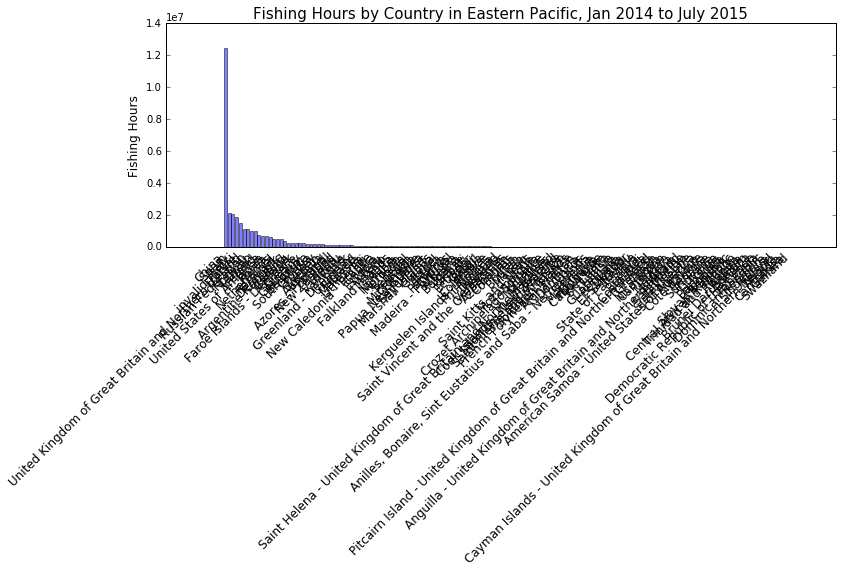

In [12]:
objects = [c[0].split(" (")[0] for c in country_groups]
y_pos = np.arange(len(objects))
performance = [c[1] for c in country_groups]
 
plt.figure(figsize=(12,4))
plt.bar(y_pos-4, performance, align='center', alpha=0.5,)
plt.xticks(y_pos-4+.2, objects, fontsize=12) # rotation=45
locs, labels = plt.xticks()
plt.setp(labels, rotation=45,ha='right')
plt.ylabel('Fishing Hours',fontsize=12)
plt.title('Fishing Hours by Country in Eastern Pacific, Jan 2014 to July 2015',fontsize=15)

ax = plt.axes()
ax.xaxis.set_ticks_position('none') 
# plt.savefig("fishing_effort_mascarene_by_Country.png",bbox_inches='tight',dpi=150,transparent=True,pad_inches=.1)
plt.show()

# Map the Fishing Effort in This Region

In [13]:
# Now Group by Country
q = '''
SELECT
  INTEGER(floor(lat*4)) lat_bin,
  INTEGER(floor(lon*4)) lon_bin,
  SUM(hours) hours
FROM
  TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31"))
WHERE
       lat > '''+str(min_lat)+'''
       AND lat <'''+str(max_lat)+'''
       AND lon > '''+str(min_lon)+'''
       AND lon < '''+str(max_lon)+'''
  AND measure_new_score >=.5
GROUP BY
  lat_bin,
  lon_bin
'''
print q
fishing_grid = Query(q)


SELECT
  INTEGER(floor(lat*4)) lat_bin,
  INTEGER(floor(lon*4)) lon_bin,
  SUM(hours) hours
FROM
  TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31"))
WHERE
       lat > -80
       AND lat <80
       AND lon > -180
       AND lon < 180
  AND measure_new_score >=.5
GROUP BY
  lat_bin,
  lon_bin

Waiting on bqjob_r775a9b657a1ff9b1_00000155cc5fc78b_5 ... (16s) Current status: DONE   
Query time: 42.6413619518 seconds.


In [14]:
cellsize = .25
one_over_cellsize = 4

num_lats = (max_lat-min_lat)*one_over_cellsize+1
num_lons = (max_lon-min_lon)*one_over_cellsize+1


grid = np.zeros(shape=(num_lats,num_lons))

for row in fishing_grid:
    lat = int(row[0])
    lon = int(row[1])
    lat_index = lat-min_lat*one_over_cellsize
    lon_index = lon-min_lon*one_over_cellsize
    grid[lat_index][lon_index] = float(row[2])

In [21]:
def makeMap(grid,fig_title,fig_max_value):
    plt.rcParams["figure.figsize"] = [12,9]

    firstlat = max_lat
    lastlat =  min_lat
    firstlon = min_lon
    lastlon = max_lon
    scale = cellsize

    numlats = int((firstlat-lastlat)/scale+.5)
    numlons = int((lastlon-firstlon)/scale+.5)

    lat_boxes = np.linspace(lastlat,firstlat,num=numlats,endpoint=False)
    lon_boxes = np.linspace(firstlon,lastlon,num=numlons,endpoint=False)

    fig = plt.figure()
    extra = 0
    m = Basemap(llcrnrlat=lastlat-extra, urcrnrlat=firstlat+extra,
              llcrnrlon=firstlon-extra, urcrnrlon=lastlon+extra, lat_ts=0, projection='mill',resolution="h")

    m.drawmapboundary()#fill_color='#111111')
    m.drawcoastlines(linewidth=.2)
    m.fillcontinents('#cccccc',lake_color='#cccccc')#, lake_color, ax, zorder, alpha)

    x = np.linspace(firstlon, lastlon, -(firstlon-lastlon)*one_over_cellsize+1)
    y = np.linspace(lastlat, firstlat, (firstlat-lastlat)*one_over_cellsize+1)
    x, y = np.meshgrid(x, y)
    converted_x, converted_y = m(x, y)
    from matplotlib import colors,colorbar

    maximum = fig_max_value # grid.max()
    minimum = .1 #1

    norm = colors.LogNorm(vmin=minimum, vmax=maximum)
    # norm = colors.Normalize(vmin=0, vmax=1000)

    m.pcolormesh(converted_x, converted_y, grid, norm=norm, vmin=minimum, vmax=maximum, cmap = plt.get_cmap('viridis'))

    t = fig_title
    plt.title(t, color = "#000000", fontsize=18)

    ax = fig.add_axes([0.2, 0.1, 0.65, 0.02]) #x coordinate , 
    norm = colors.LogNorm(vmin=minimum, vmax=maximum)
    # norm = colors.Normalize(vmin=0, vmax=1000)
    lvls = np.logspace(np.log10(minimum),np.log10(maximum),num=8)
    cb = colorbar.ColorbarBase(ax,norm = norm, orientation='horizontal', ticks=lvls, cmap = plt.get_cmap('viridis'))

    #cb.ax.set_xticklabels(["0" ,round(m3**.5,1), m3, round(m3**1.5,1), m3*m3,round(m3**2.5,1), str(round(m3**3,1))+"+"], fontsize=10)
    cb.ax.set_xticklabels([int(i) for i in lvls], fontsize=10, color = "#000000")
    cb.set_label('Fishing Hours',labelpad=-40, y=0.45, color = "#000000")
    plt.savefig("../../data/bycountry/"+fig_title+".png",bbox_inches='tight',dpi=300,transparent=True,pad_inches=.1)
    plt.show()

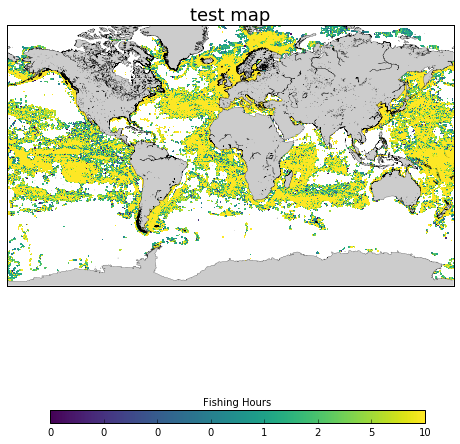

In [16]:
makeMap(grid,"test map",10)

In [17]:
for c in country_groups:
    print c[0]

China (People's Republic of)
Spain
Italy
invalid mmsi
France
United Kingdom of Great Britain and Northern Ireland
Russian Federation
Norway
Taiwan (Province of China) - China (People's Republic of)
Iceland
United States of America
Japan
Korea (Republic of)
Netherlands (Kingdom of the)
Portugal
Denmark
Argentine Republic
Ireland
Canada
Faroe Islands - Denmark
Greece
Germany (Federal Republic of)
Belgium
South Africa (Republic of)
Croatia (Republic of)
Turkey
Sweden
Australia
Poland (Republic of)
Azores - Portugal
New Zealand
Latvia (Republic of)
Vanuatu (Republic of)
Chile
Greenland - Denmark
Uruguay (Eastern Republic of)
Finland
Malaysia
Lithuania (Republic of)
Fiji (Republic of)
New Caledonia - France
Ghana
Estonia (Republic of)
Peru
Mexico
Falkland Islands (Malvinas) - United Kingdom of Great Britain and Northern Ireland
Malta
Namibia (Republic of)
Morocco (Kingdom of)
India (Republic of)
Senegal (Republic of)
Reunion (French Department of) - France
Micronesia (Federated States of)
U

In [18]:
q = '''select 
a.lat_bin lat_bin,
a.lon_bin lon_bin,
a.hours hours,
IF(b.country IS NULL, "invalid mmsi",b.country) country,
from
(SELECT
  INTEGER(FLOOR(lat*4)) lat_bin,
  INTEGER(FLOOR(lon*4)) lon_bin,
  SUM(hours) hours,
  INTEGER(IF(LENGTH(STRING(mmsi))= 9,LEFT(STRING(mmsi),3), '0')) code
FROM
  TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31"))
WHERE
       lat > '''+str(min_lat)+'''
       AND lat <'''+str(max_lat)+'''
       AND lon > '''+str(min_lon)+'''
       AND lon < '''+str(max_lon)+'''
  AND measure_new_score >=.5  
GROUP BY
  lat_bin,
  lon_bin,
  code)a
  left join 
   [scratch_roan.country_code] b
  ON
    a.code = b.code
--   where b.country = "United States of America"'''
print q

bycountry = Query(q)

select 
a.lat_bin lat_bin,
a.lon_bin lon_bin,
a.hours hours,
IF(b.country IS NULL, "invalid mmsi",b.country) country,
from
(SELECT
  INTEGER(FLOOR(lat*4)) lat_bin,
  INTEGER(FLOOR(lon*4)) lon_bin,
  SUM(hours) hours,
  INTEGER(IF(LENGTH(STRING(mmsi))= 9,LEFT(STRING(mmsi),3), '0')) code
FROM
  TABLE_DATE_RANGE([pipeline_classify_logistic_661b_fishing.], TIMESTAMP("2015-01-01"), TIMESTAMP("2015-12-31"))
WHERE
       lat > -80
       AND lat <80
       AND lon > -180
       AND lon < 180
  AND measure_new_score >=.5  
GROUP BY
  lat_bin,
  lon_bin,
  code)a
  left join 
   [scratch_roan.country_code] b
  ON
    a.code = b.code
--   where b.country = "United States of America"
Waiting on bqjob_r241780b06052341b_00000155cc611db9_6 ... (23s) Current status: DONE   
Query time: 108.229253769 seconds.


China (People's Republic of)


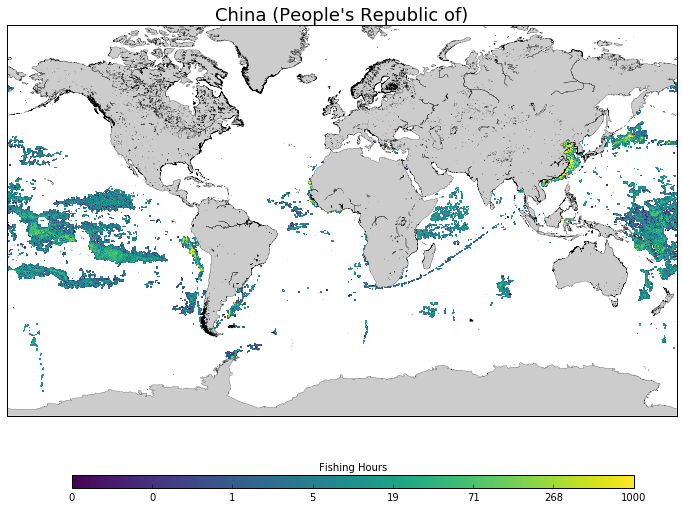

Spain


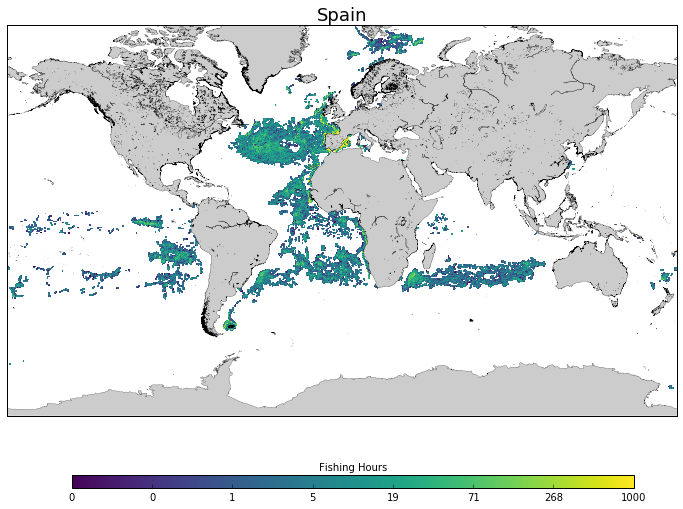

Italy


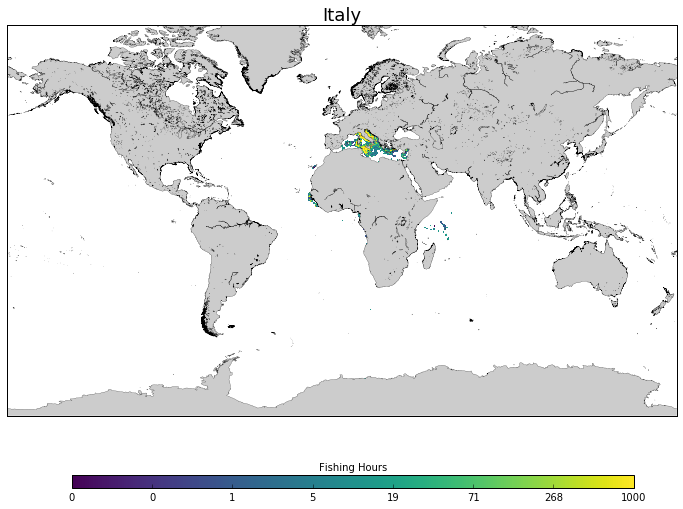

invalid mmsi


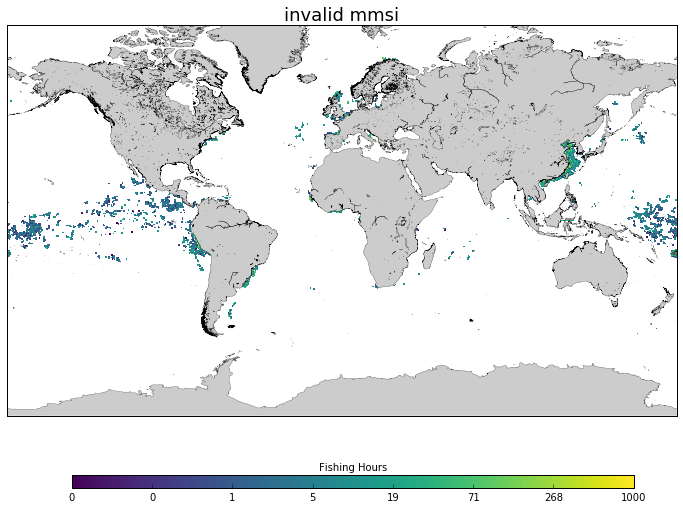

France


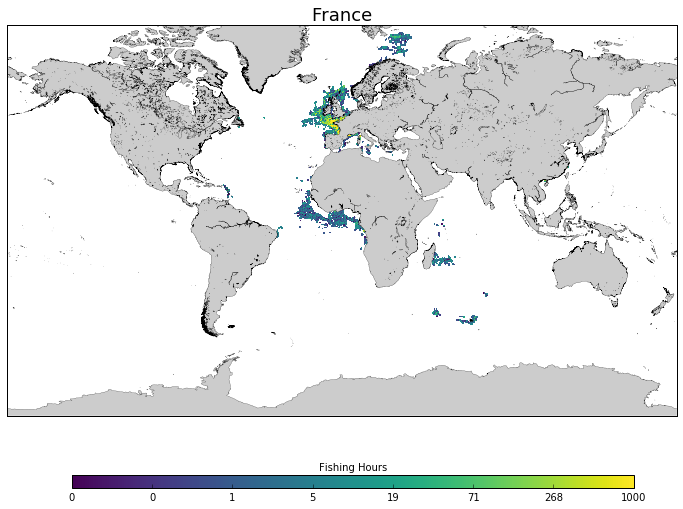

United Kingdom of Great Britain and Northern Ireland


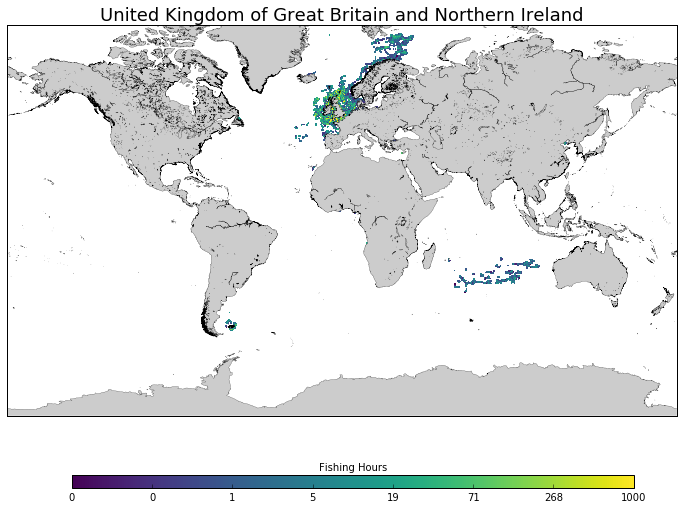

Russian Federation


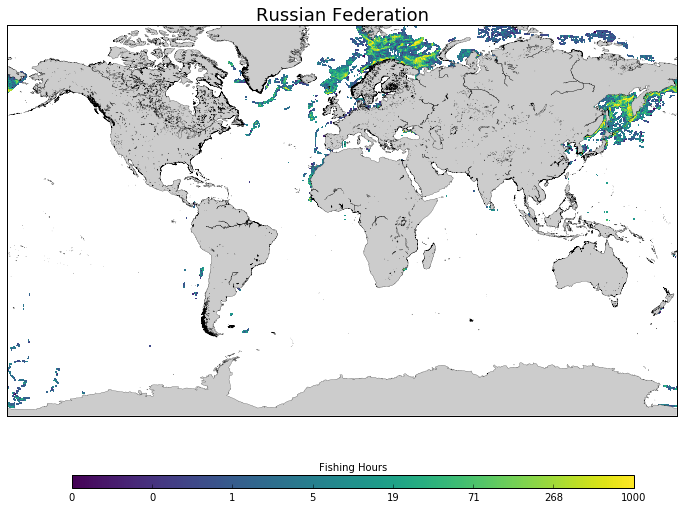

Norway


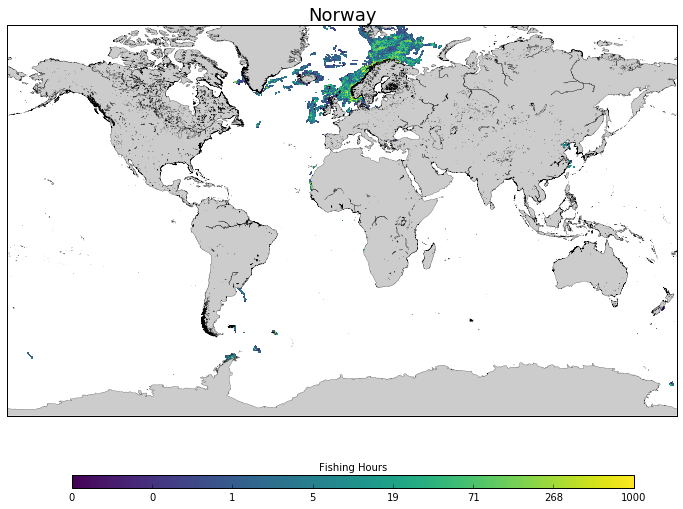

Taiwan (Province of China) - China (People's Republic of)


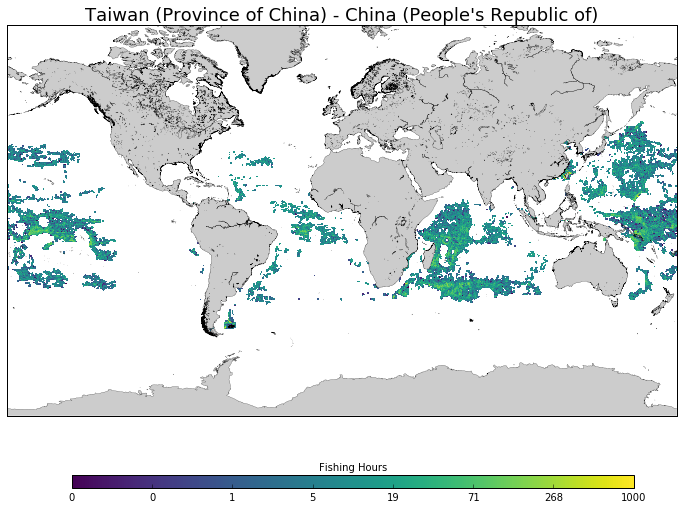

Iceland


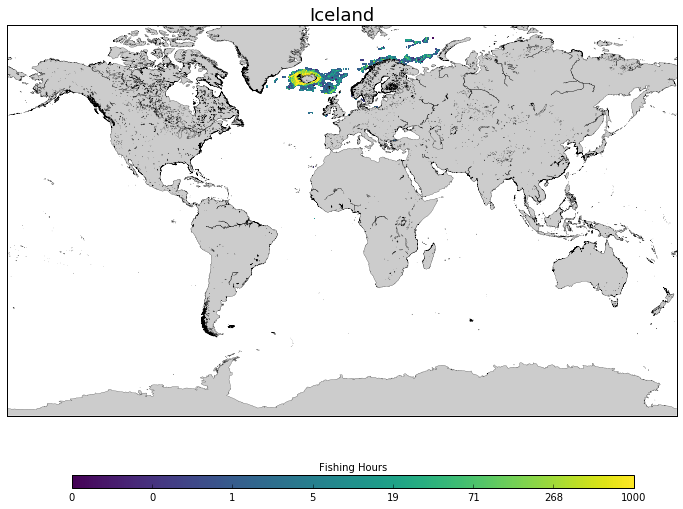

United States of America


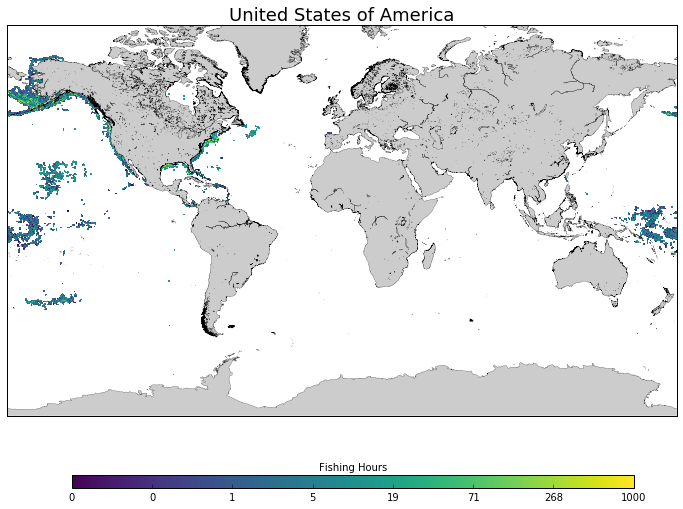

Japan


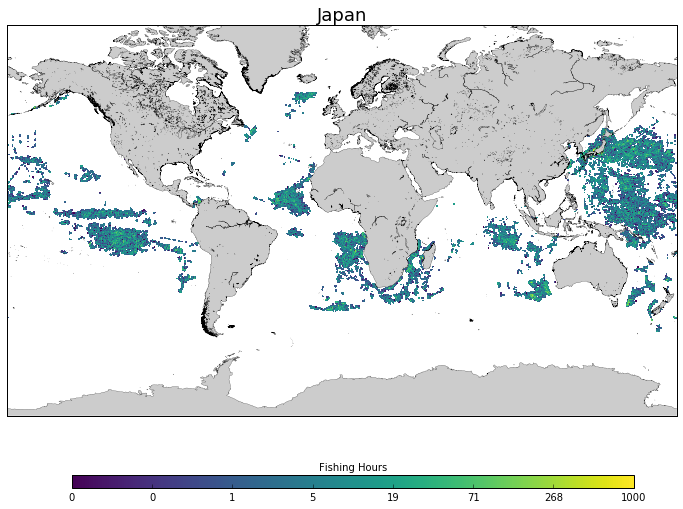

Korea (Republic of)


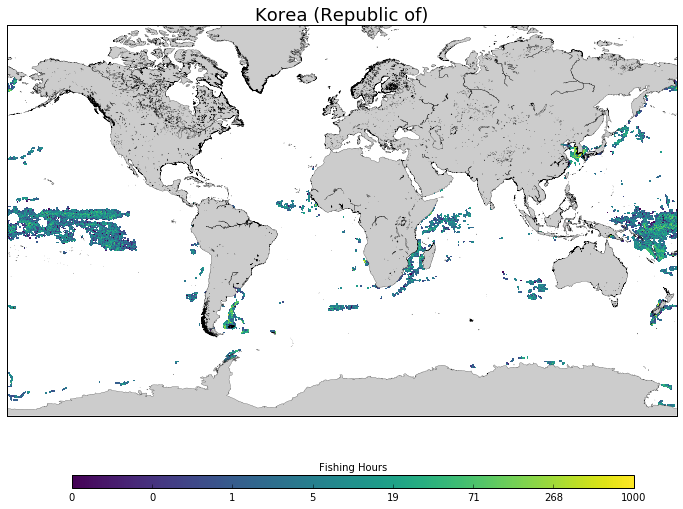

Netherlands (Kingdom of the)


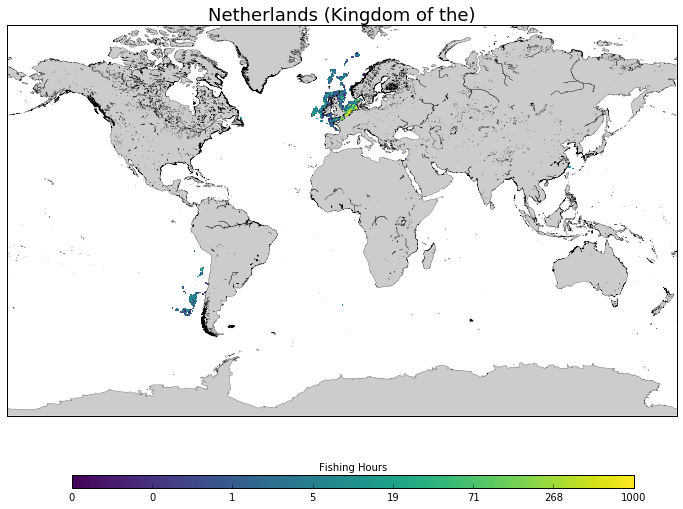

Portugal


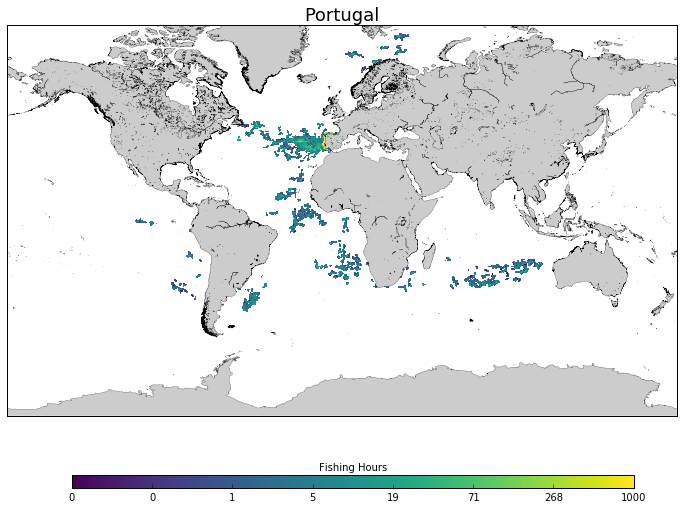

Denmark


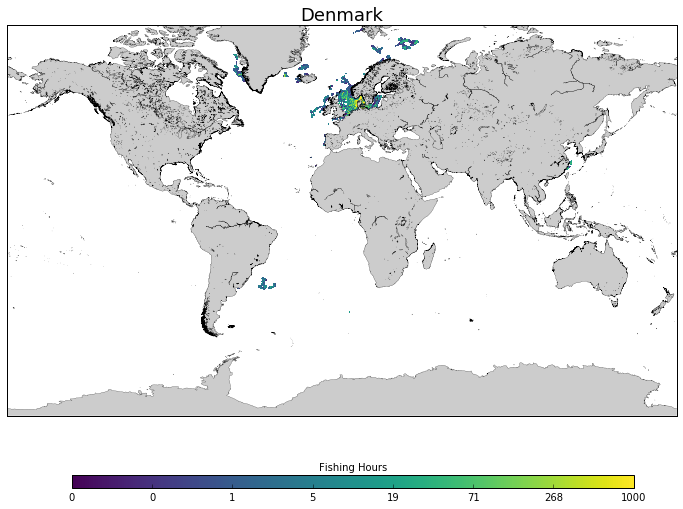

Argentine Republic


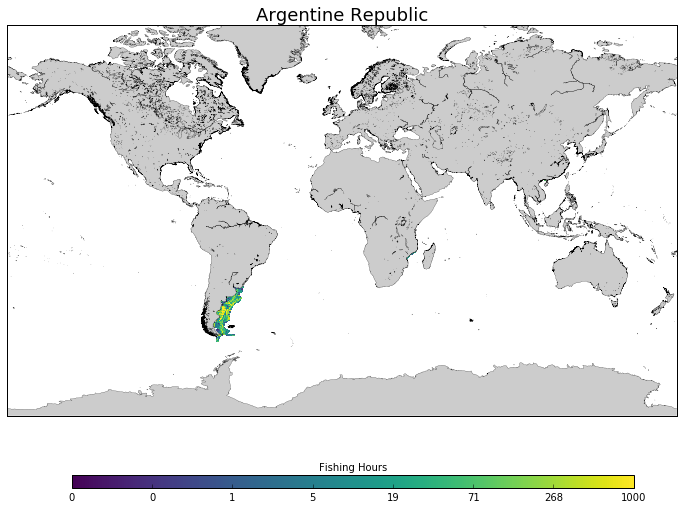

Ireland


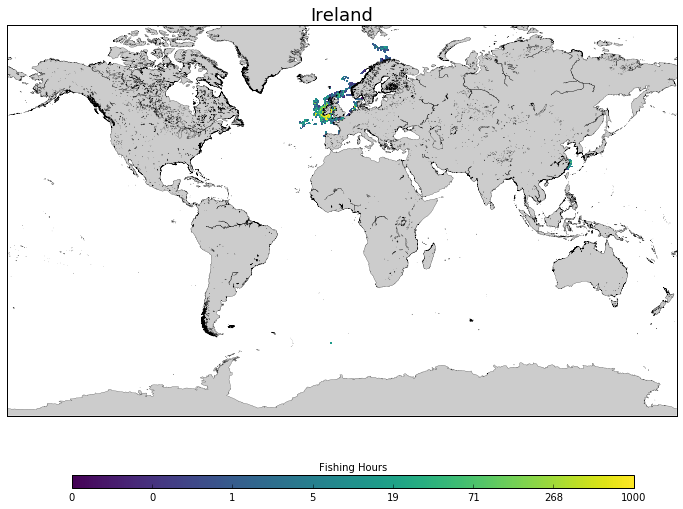

Canada


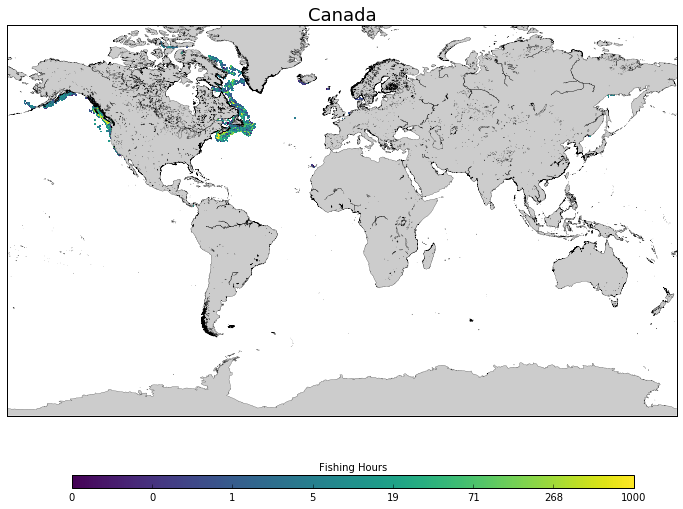

Faroe Islands - Denmark


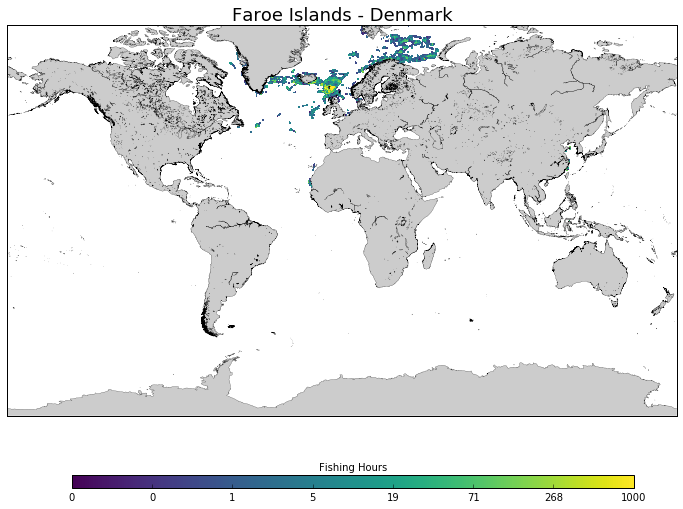

Greece


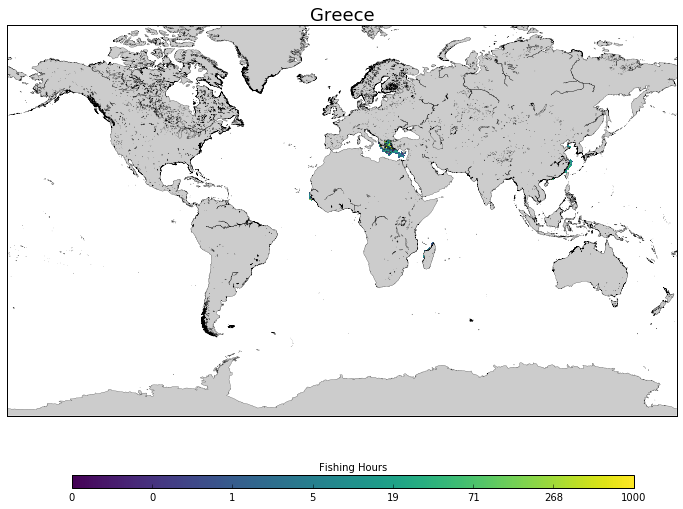

Germany (Federal Republic of)


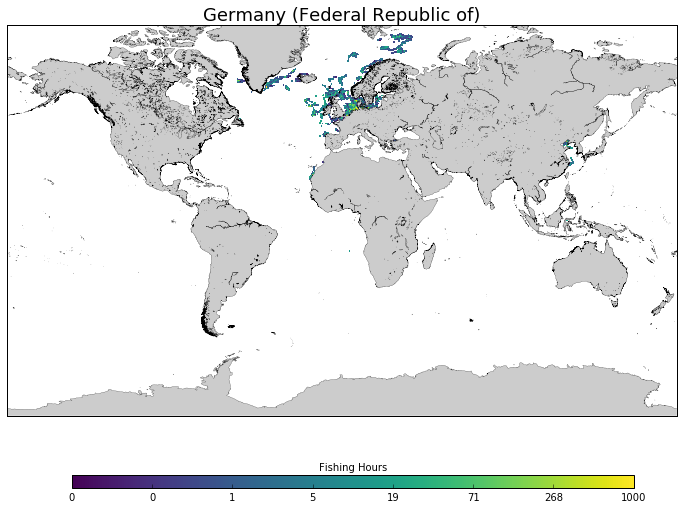

Belgium


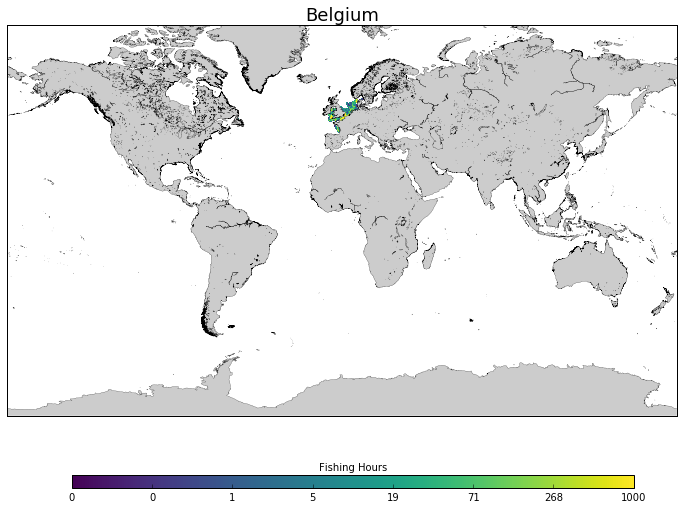

South Africa (Republic of)


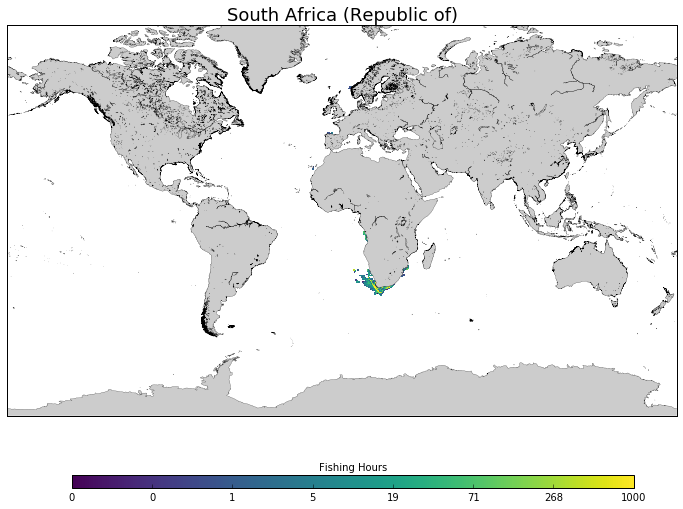

Croatia (Republic of)


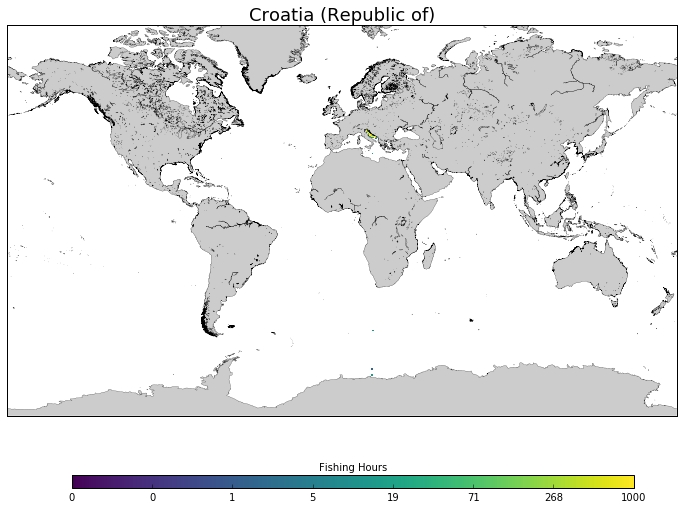

Turkey


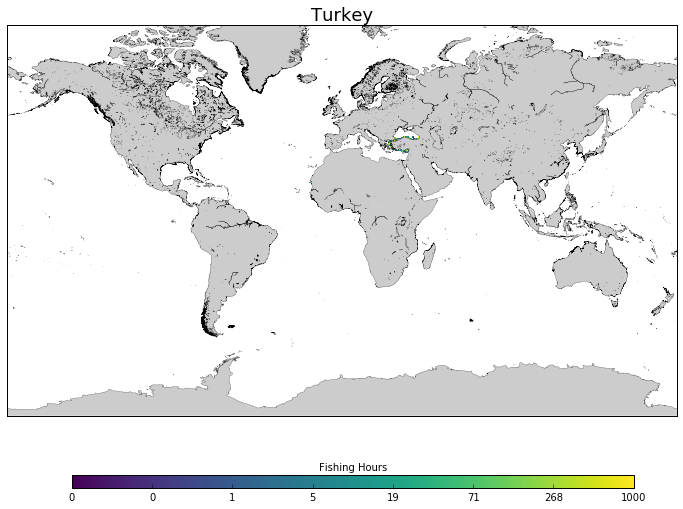

Sweden


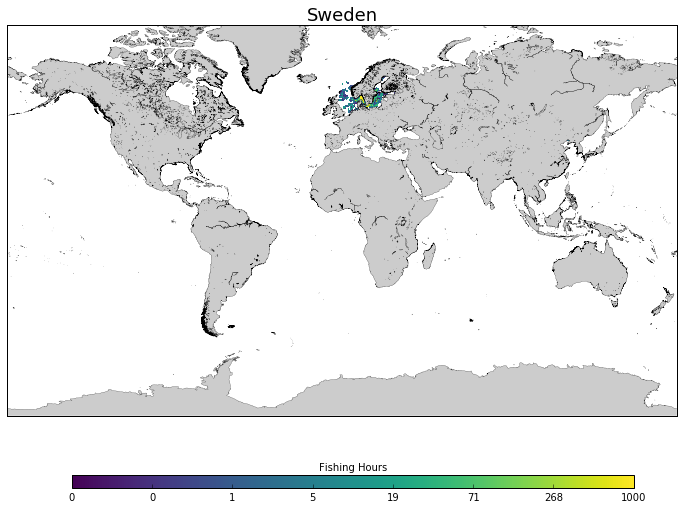

Australia


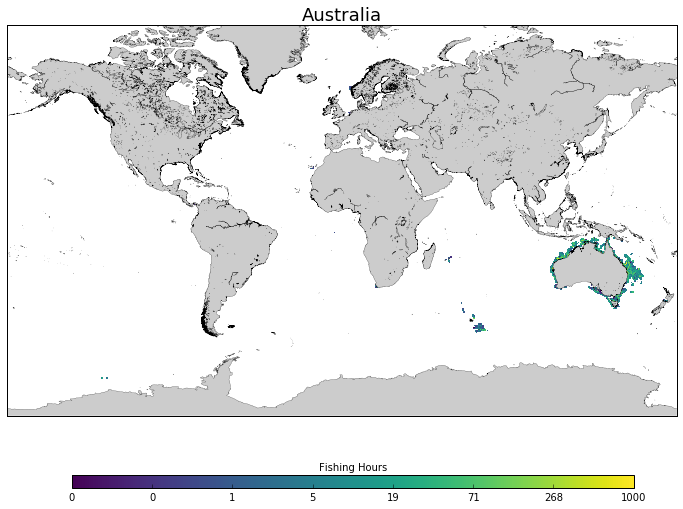

Poland (Republic of)


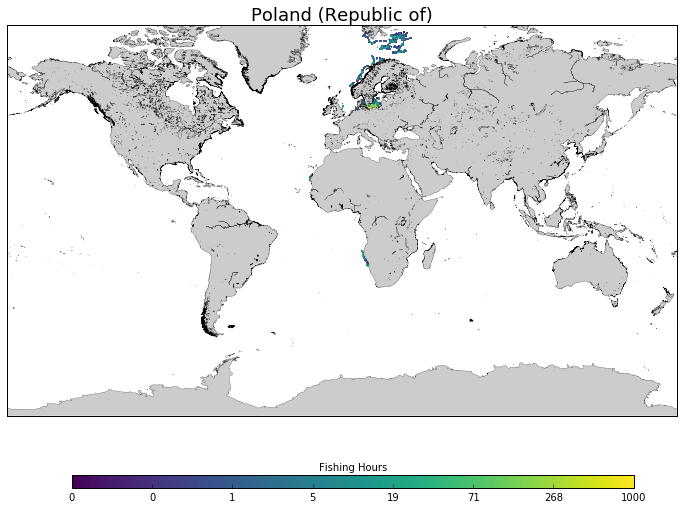

Azores - Portugal


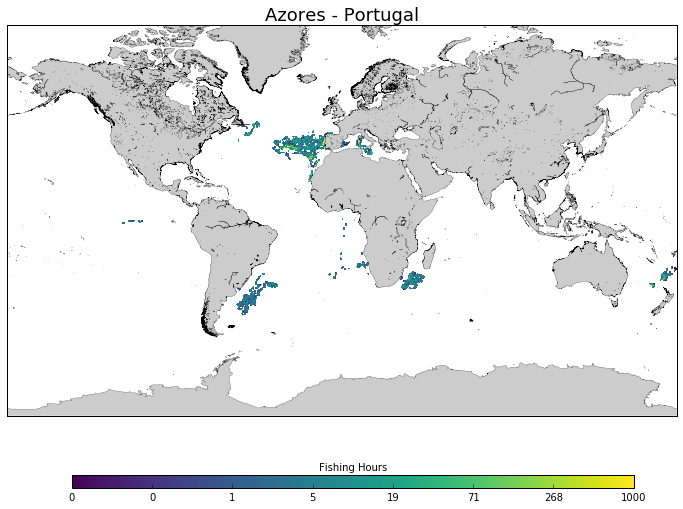

New Zealand


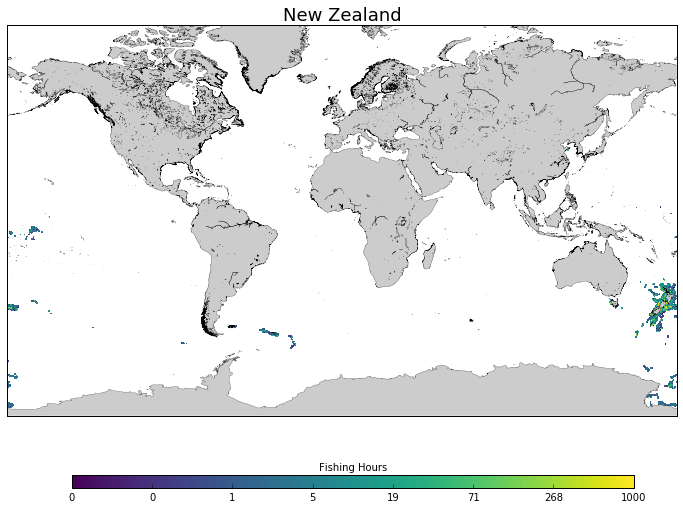

Latvia (Republic of)


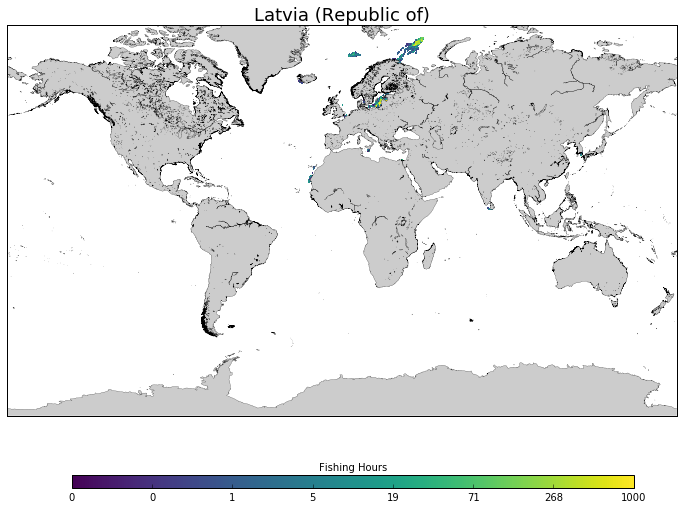

Vanuatu (Republic of)


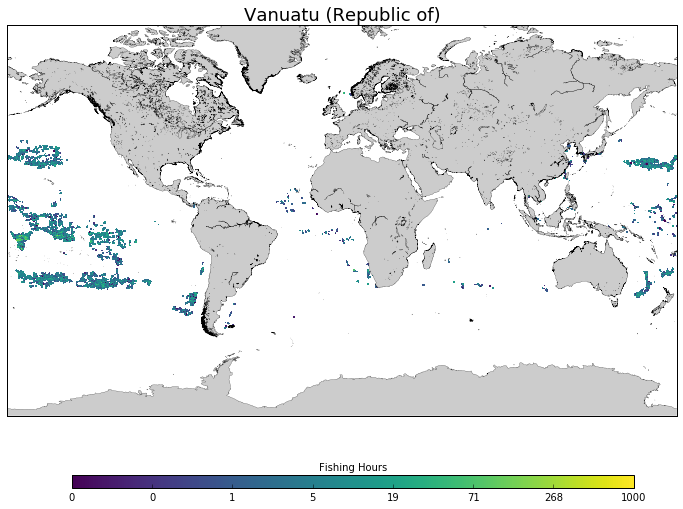

Chile


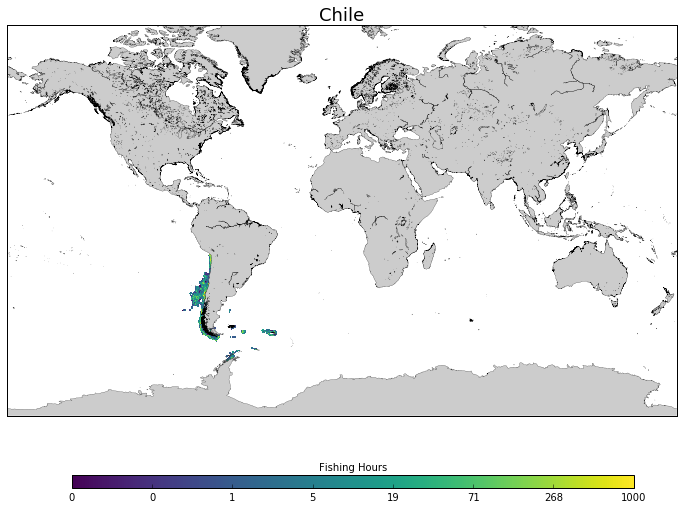

Greenland - Denmark


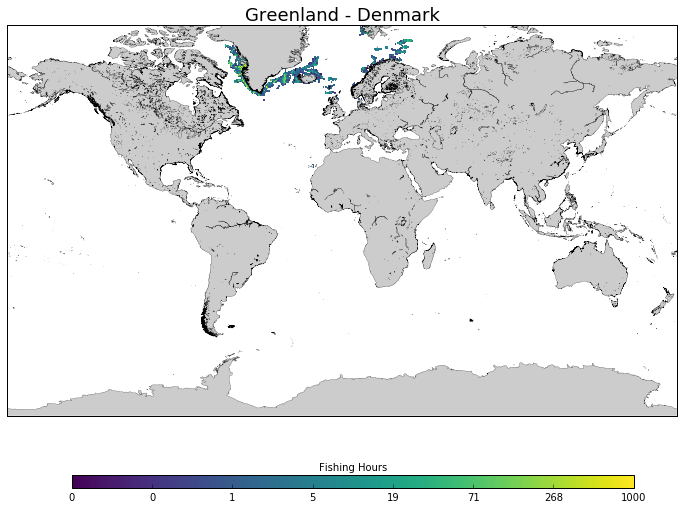

Uruguay (Eastern Republic of)


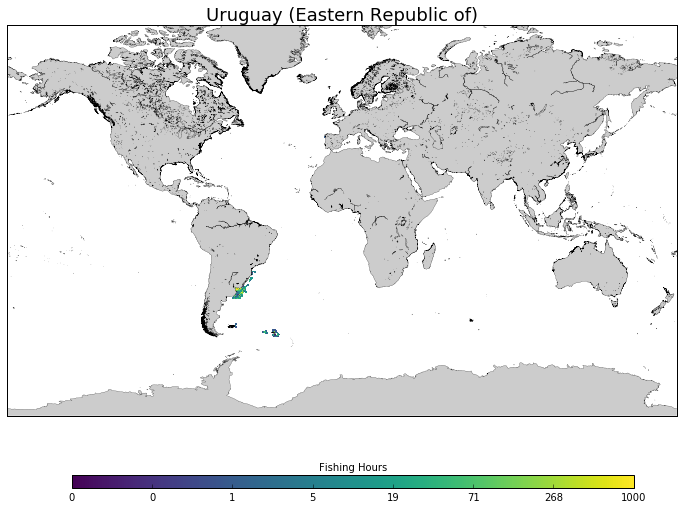

Finland


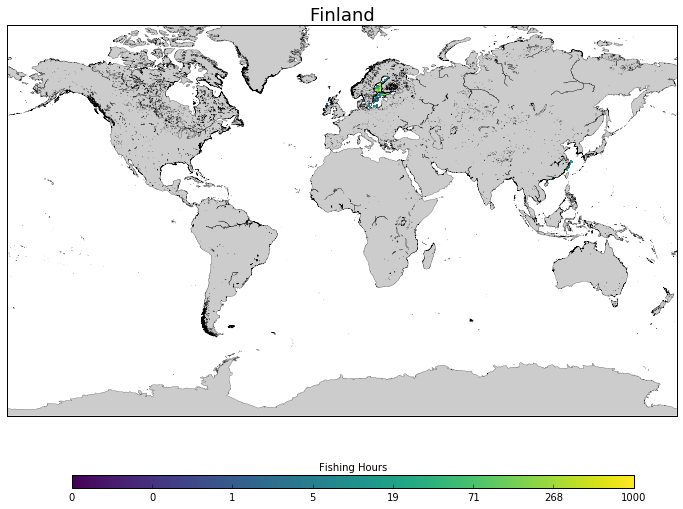

Malaysia


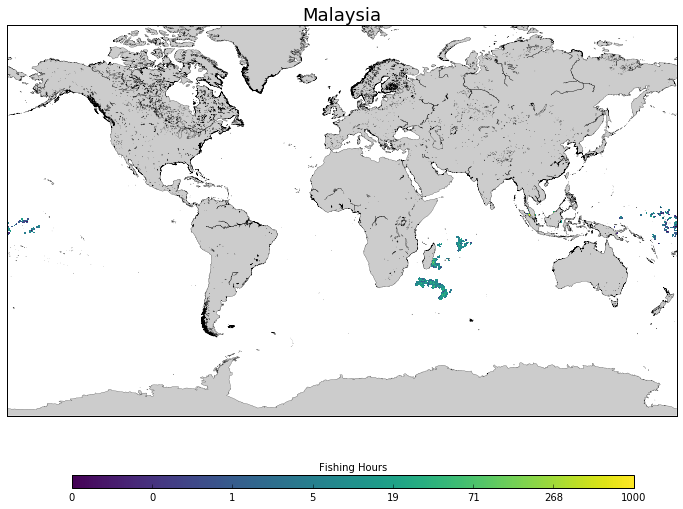

Lithuania (Republic of)


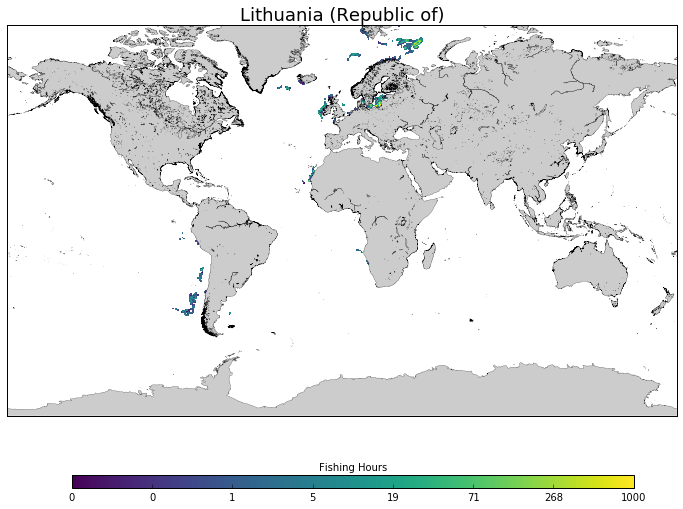

Fiji (Republic of)


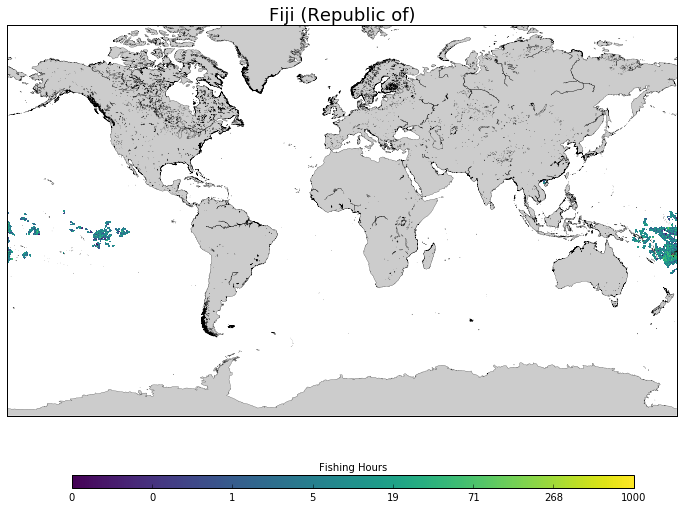

New Caledonia - France


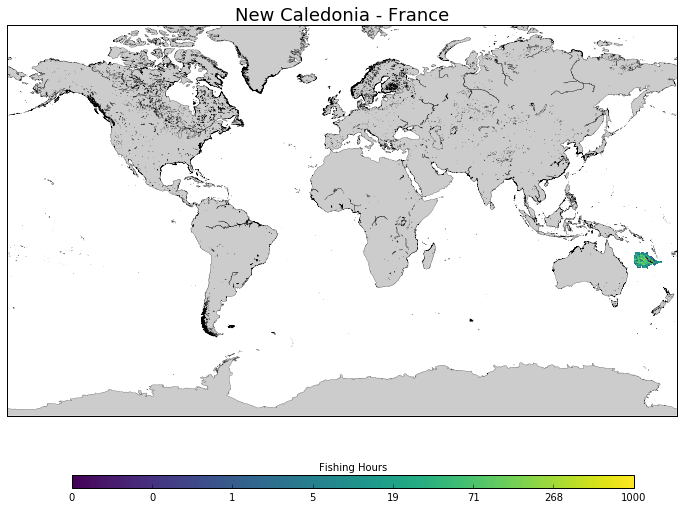

Ghana


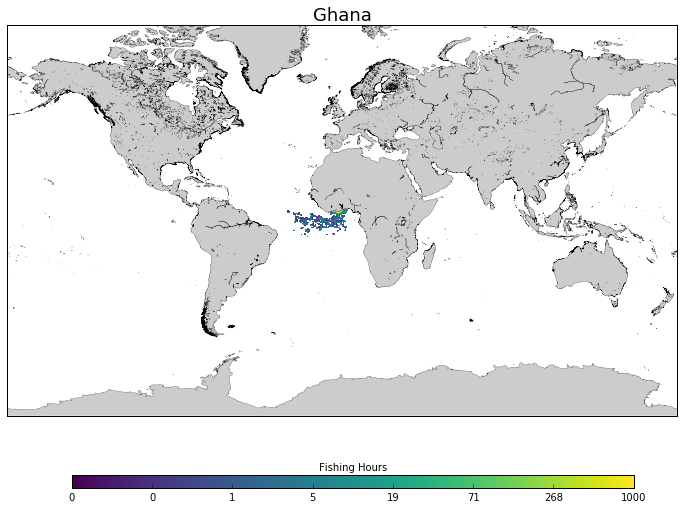

Estonia (Republic of)


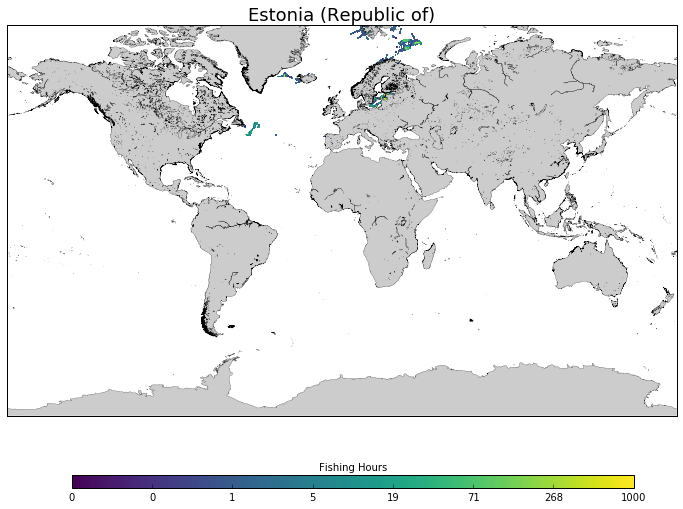

Peru


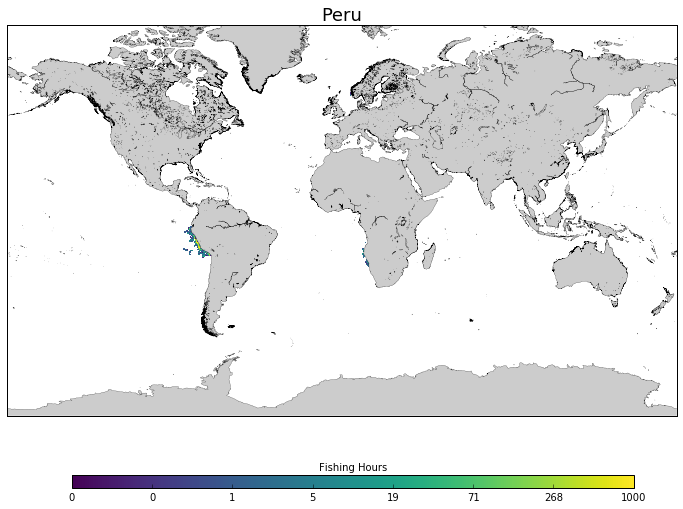

Mexico


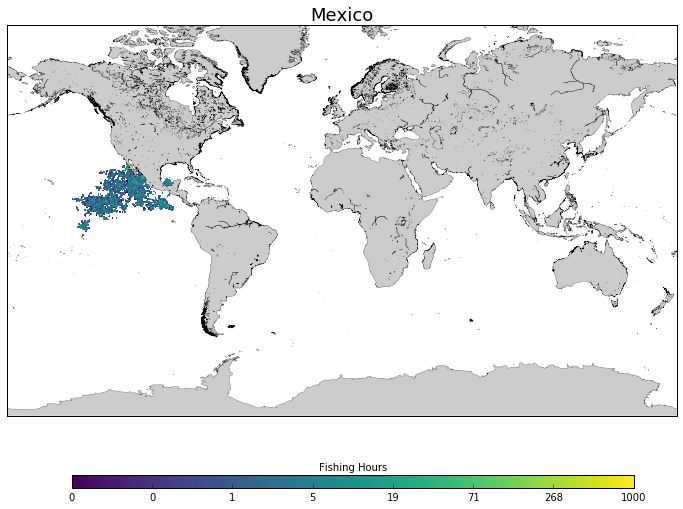

Falkland Islands (Malvinas) - United Kingdom of Great Britain and Northern Ireland


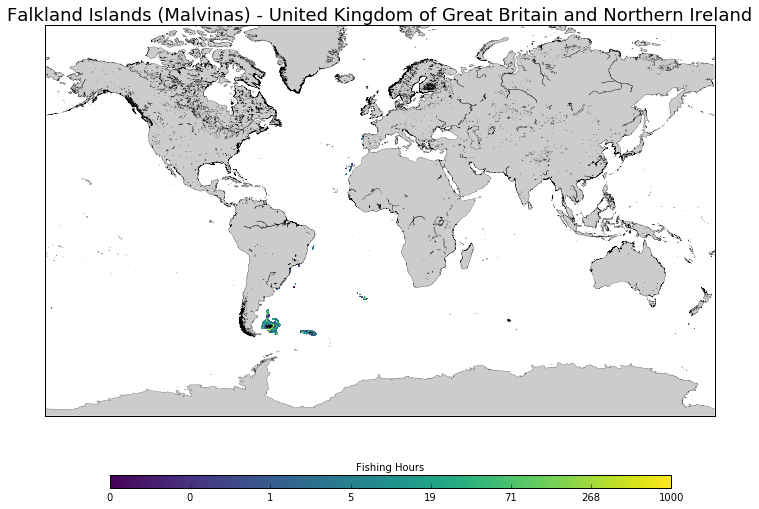

Malta


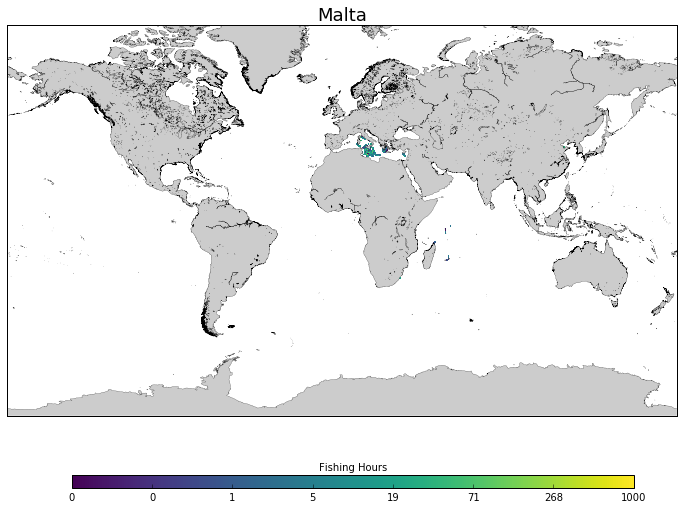

Namibia (Republic of)


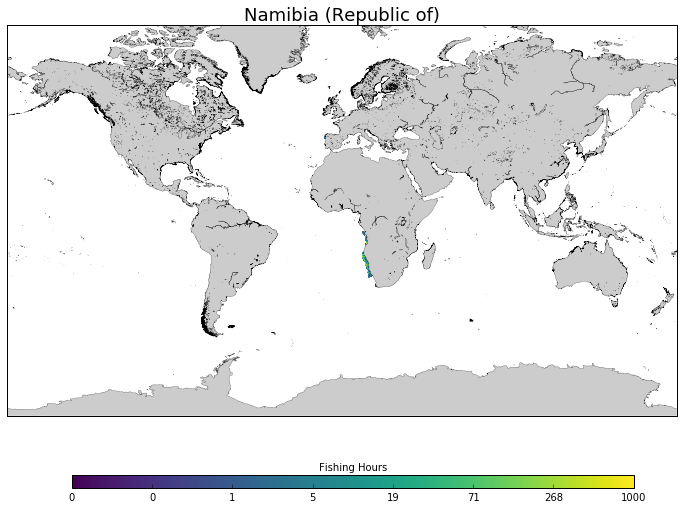

Morocco (Kingdom of)


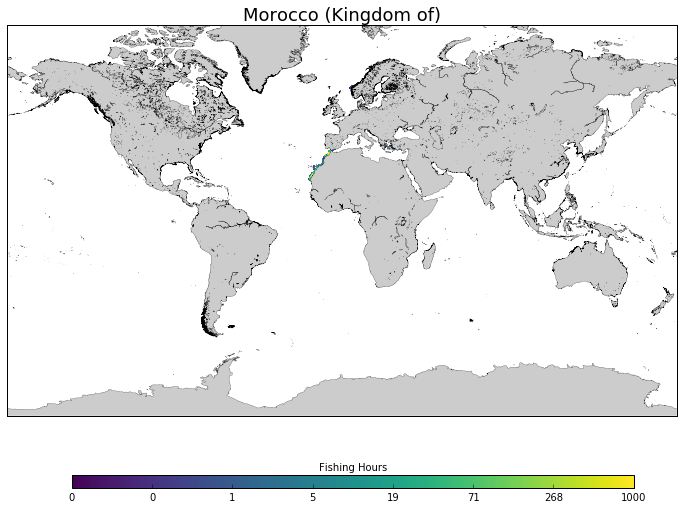

India (Republic of)


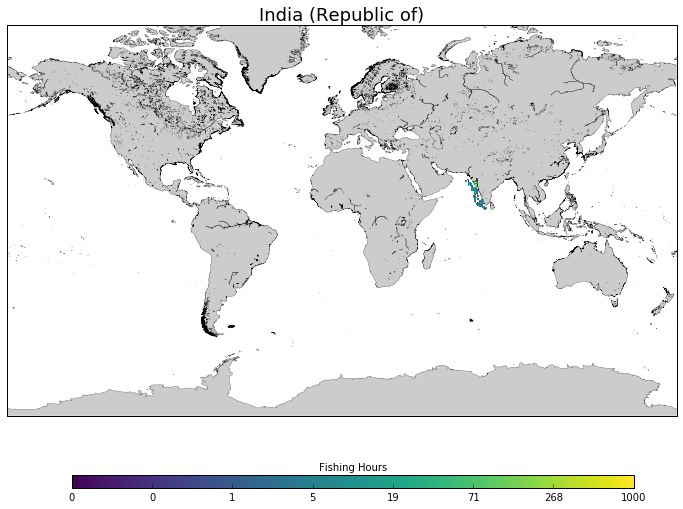

Senegal (Republic of)


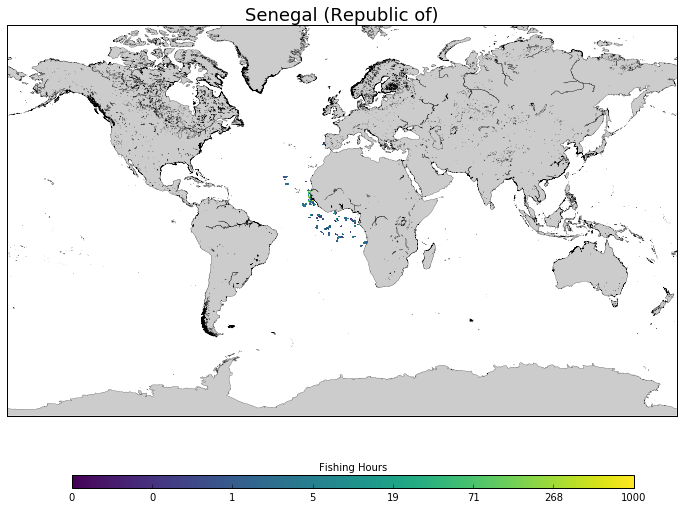

Reunion (French Department of) - France


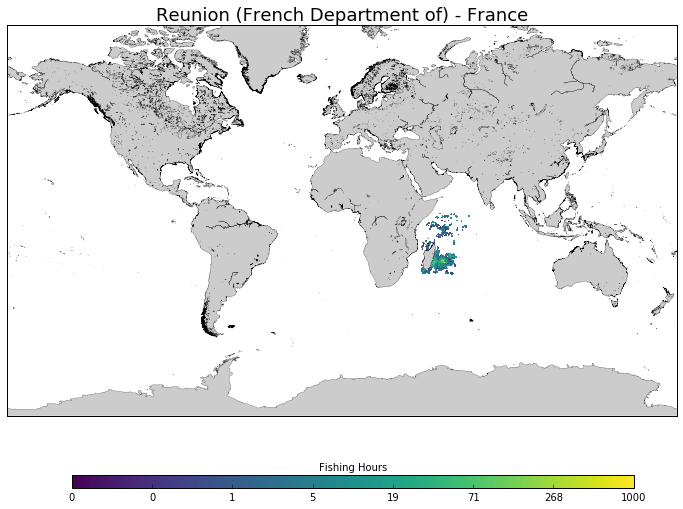

Micronesia (Federated States of)


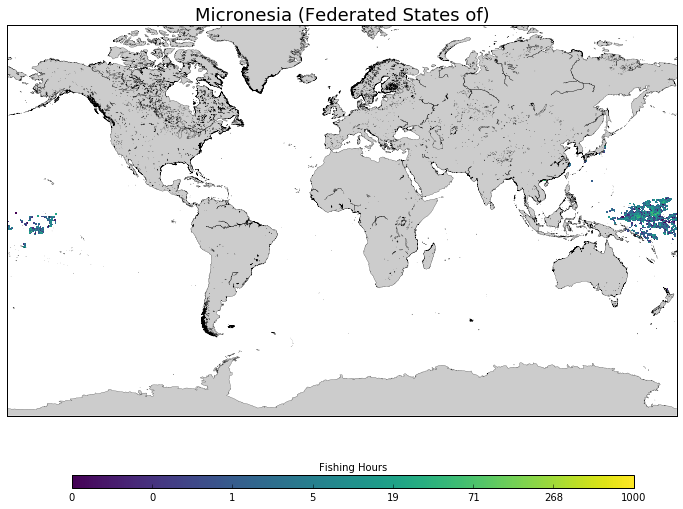

Ukraine


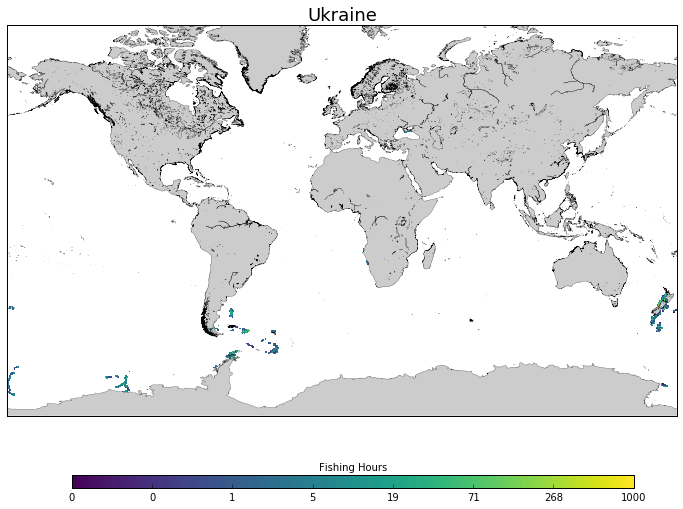

Papua New Guinea


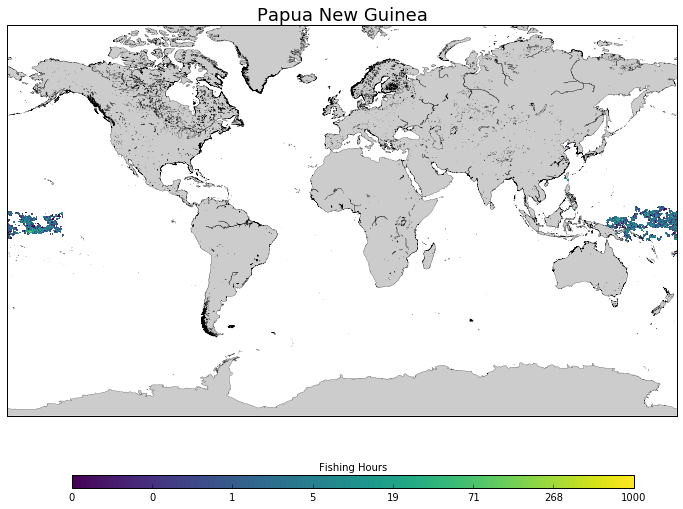

Seychelles (Republic of)


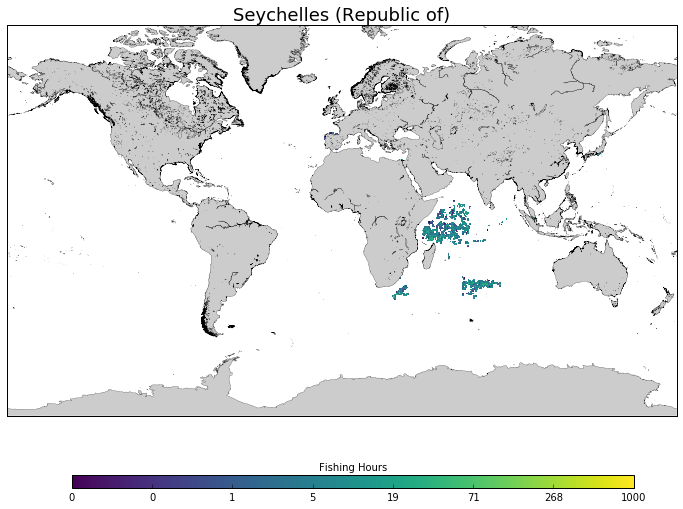

Marshall Islands (Republic of the)


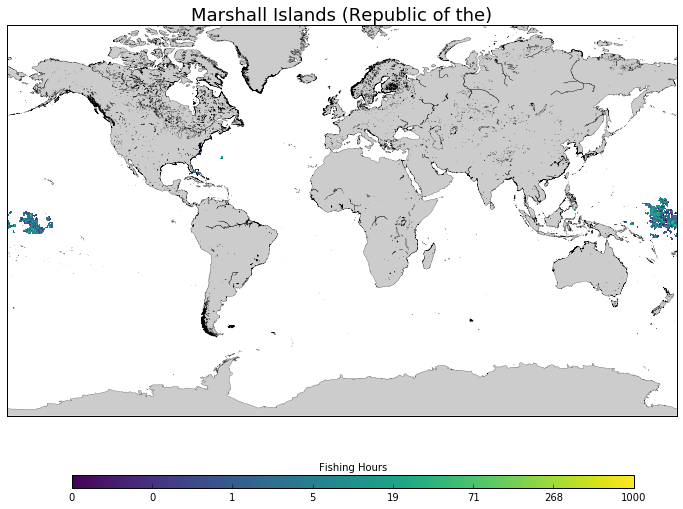

Guiana (French Department of) - France


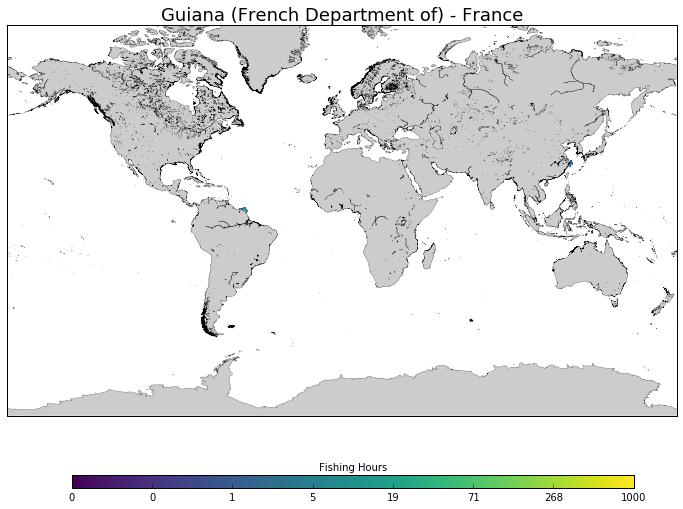

Israel (State of)


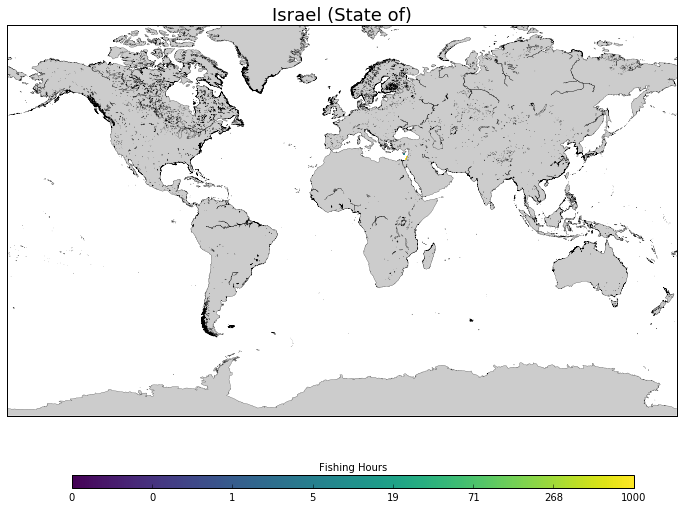

Alaska (State of) - United States of America


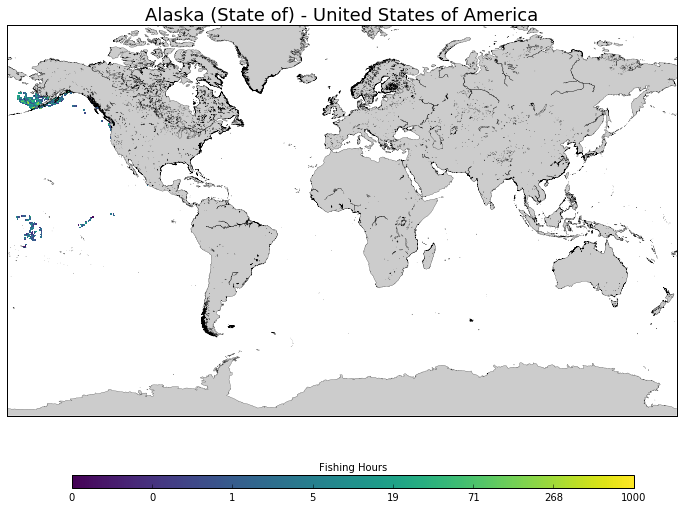

Panama (Republic of)


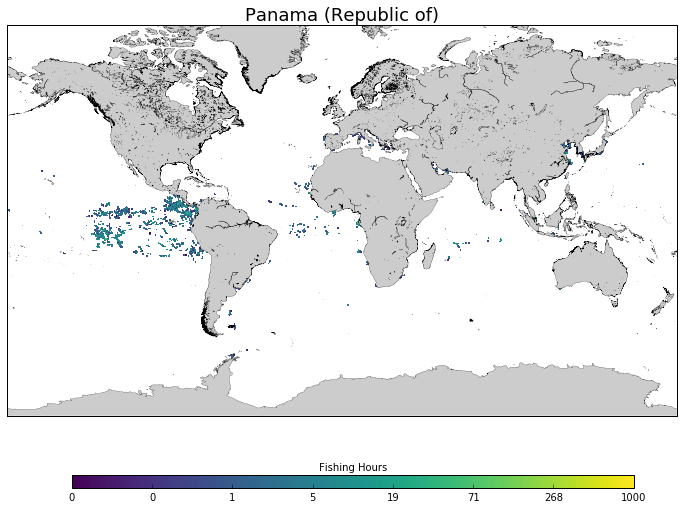

Cyprus (Republic of)


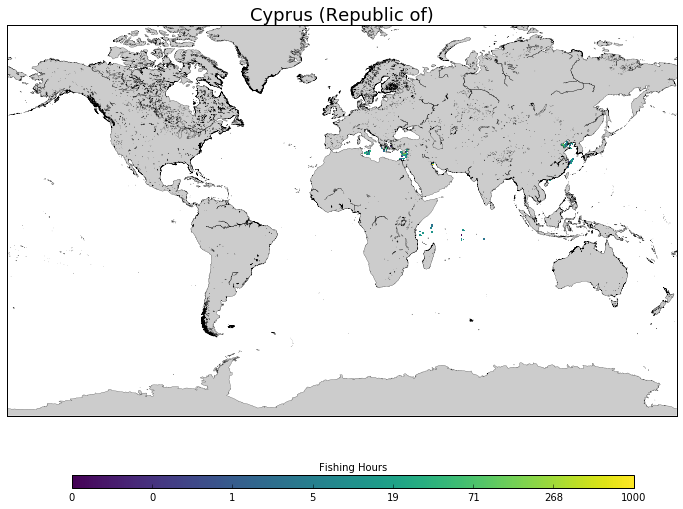

Madeira - Portugal


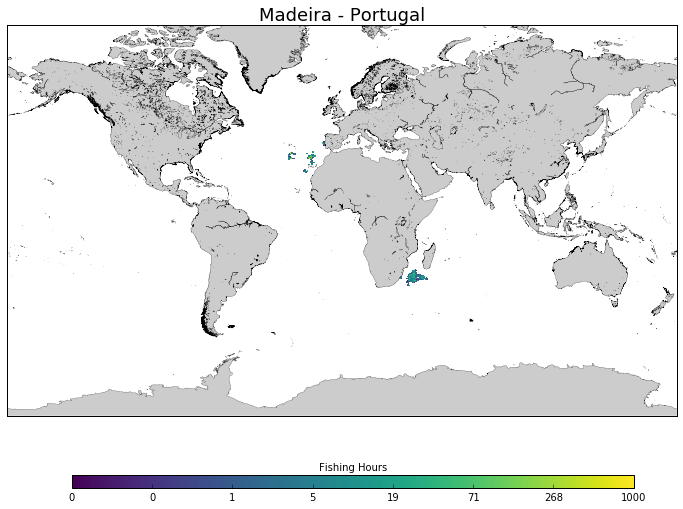

Albania (Republic of)


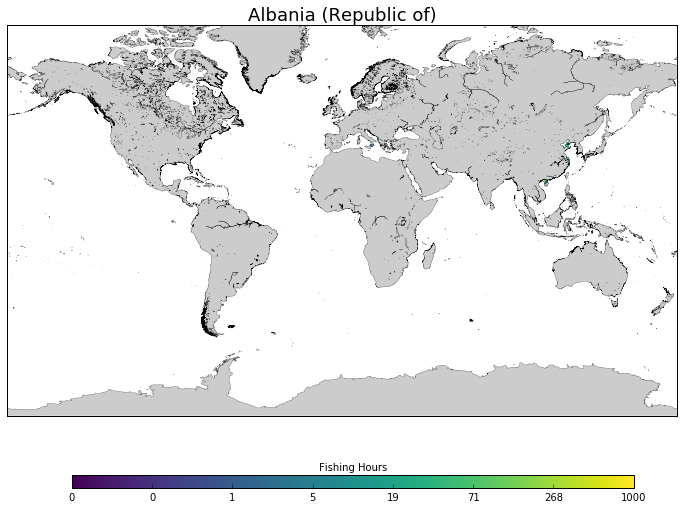

Bulgaria (Republic of)


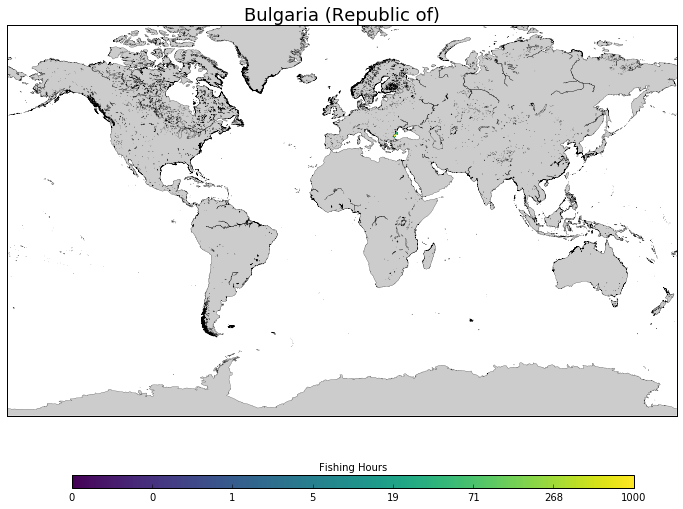

Belize


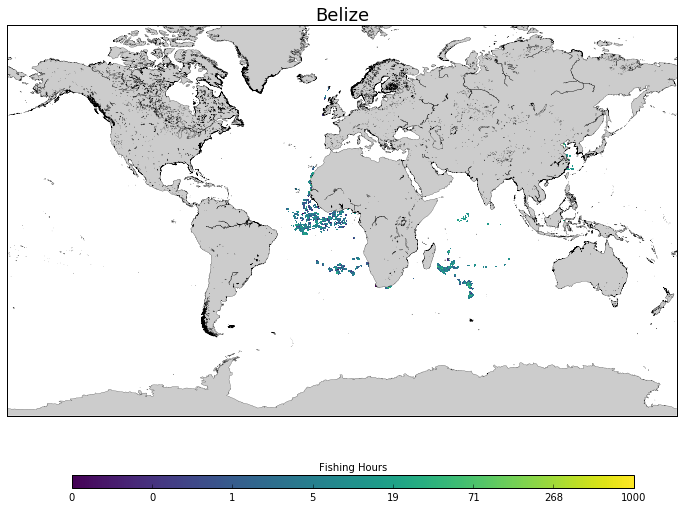

Kiribati (Republic of)


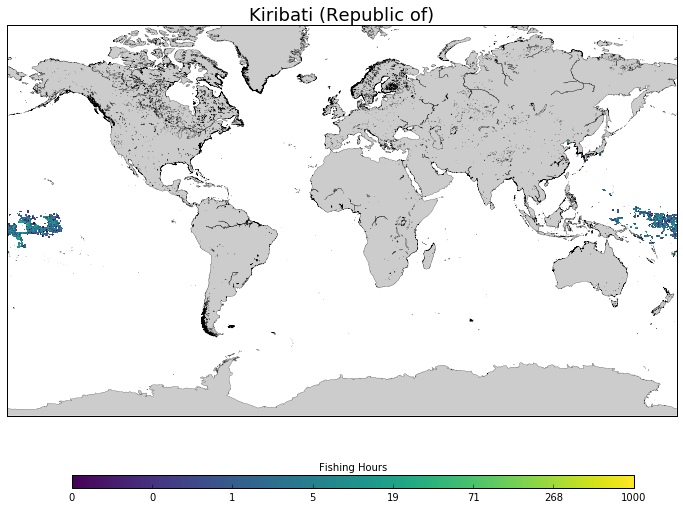

Ecuador


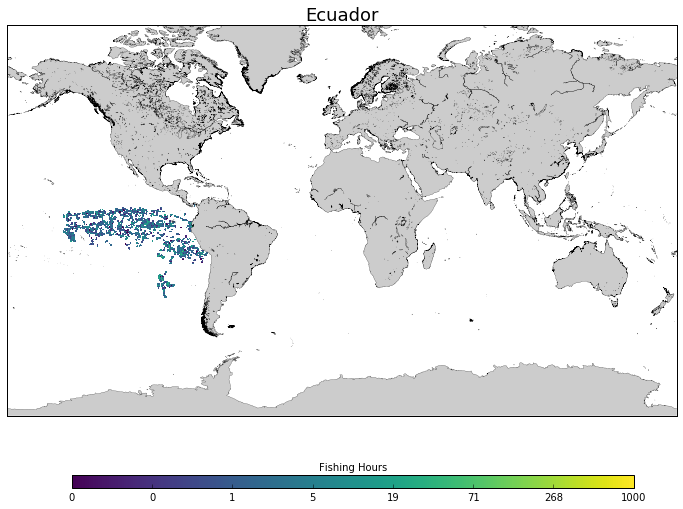

Qatar (State of)


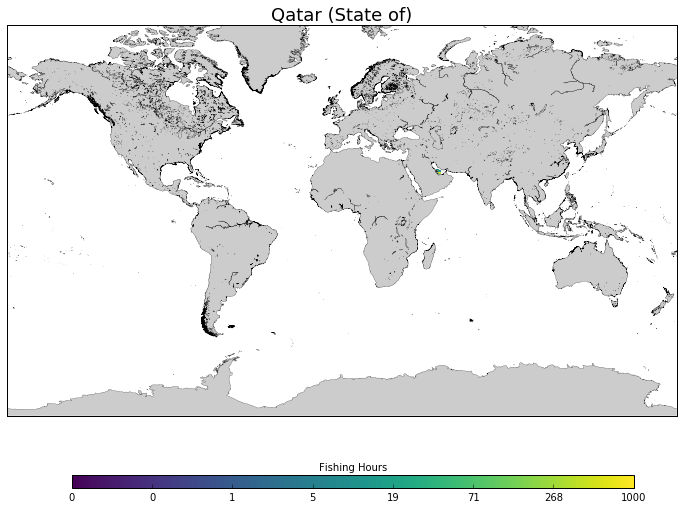

Brazil (Federative Republic of)


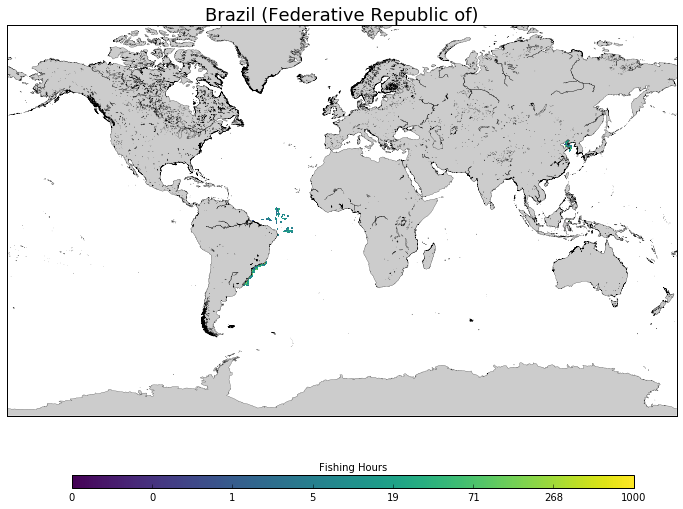

Colombia (Republic of)


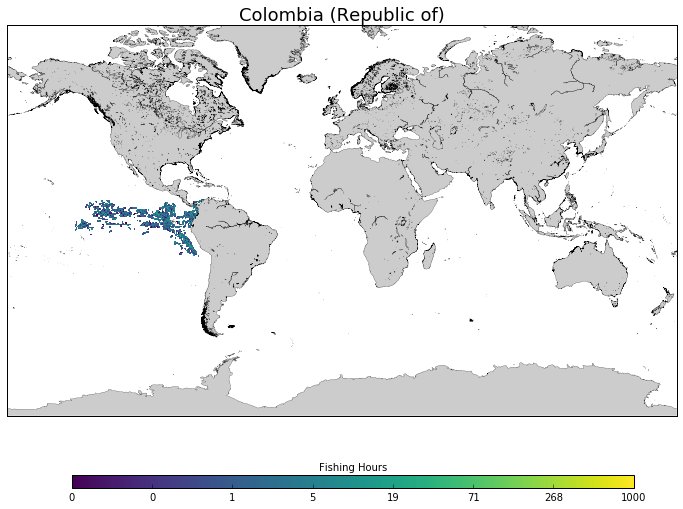

Kerguelen Islands - France


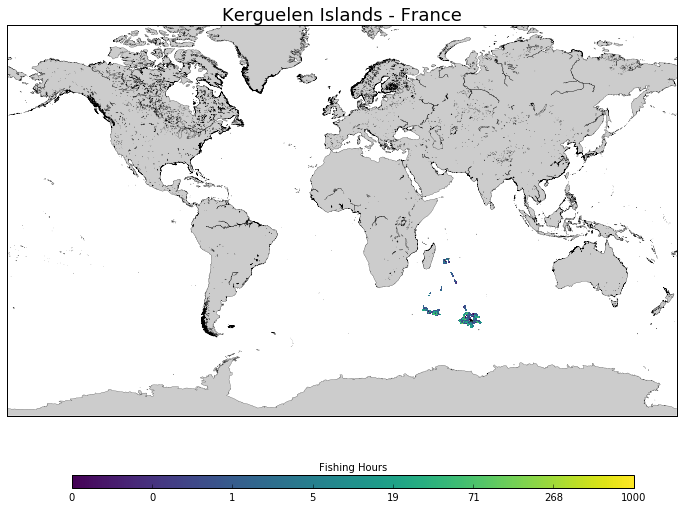

Philippines (Republic of the)


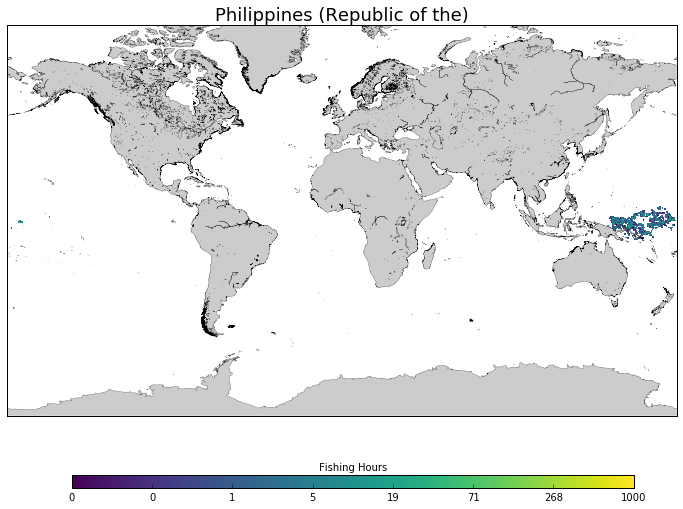

Nigeria (Federal Republic of)


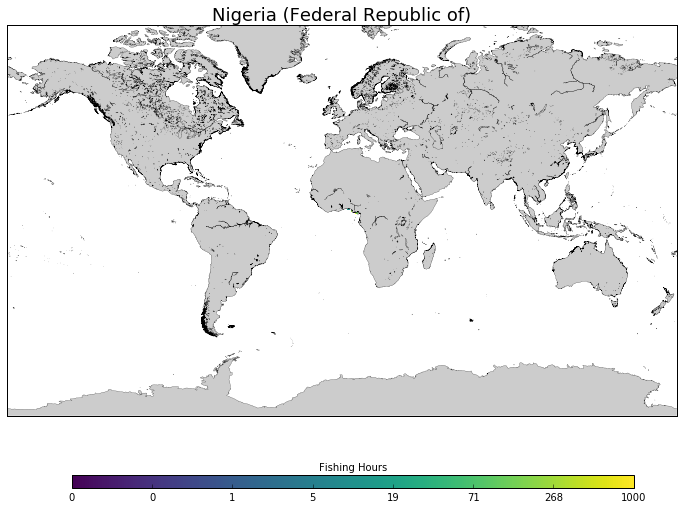

Thailand


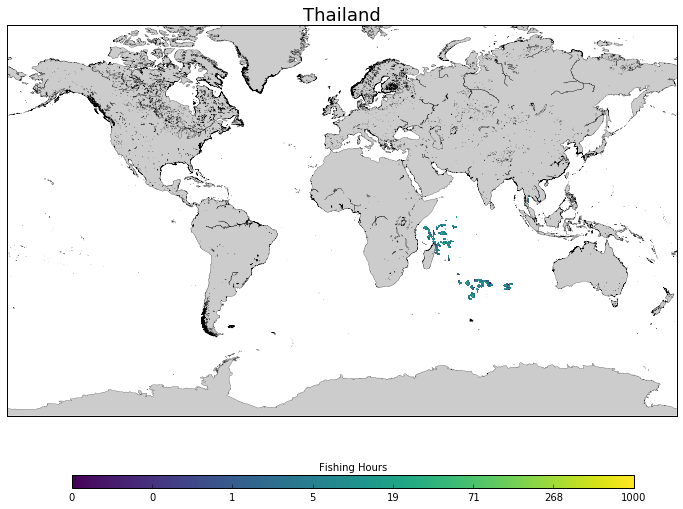

Venezuela (Bolivarian Republic of)


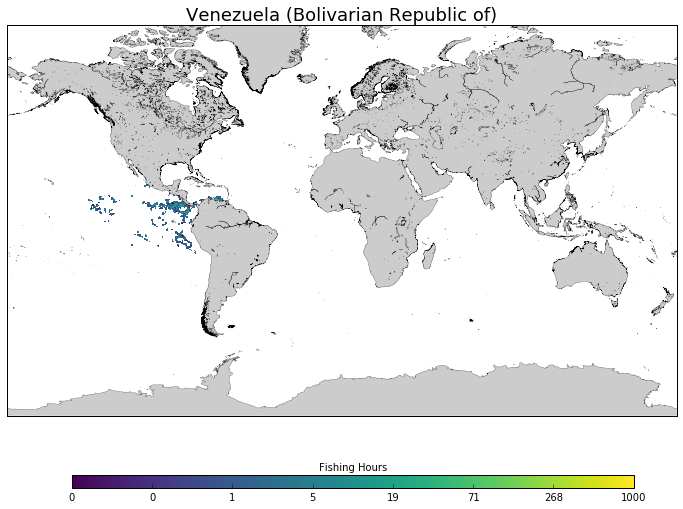

Saint Vincent and the Grenadines


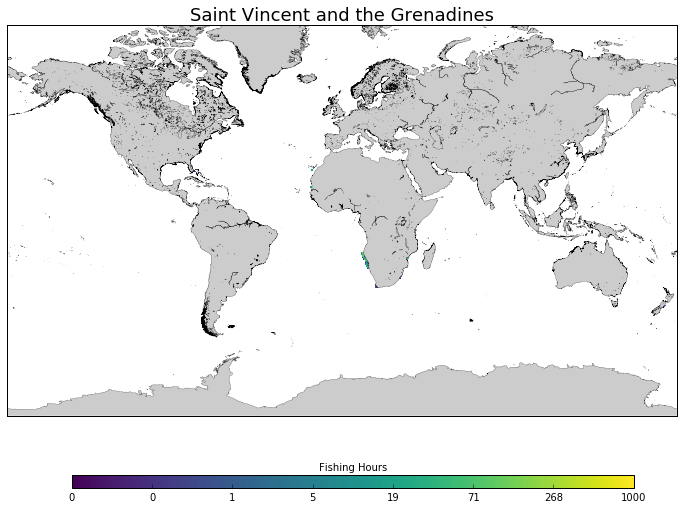

Azerbaijan (Republic of)


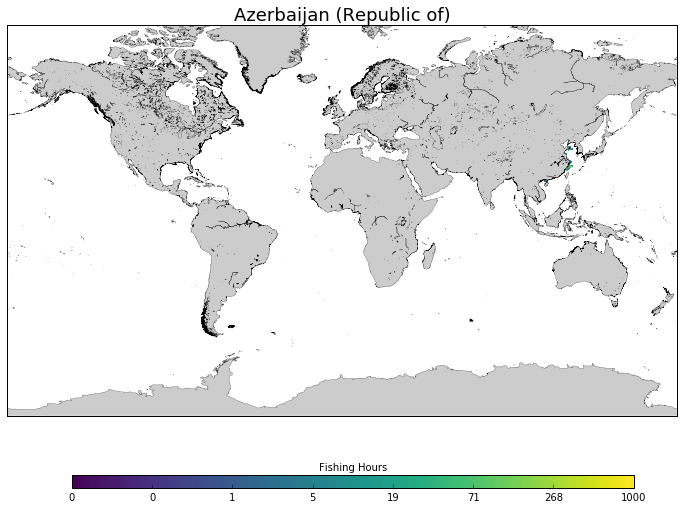

Comoros (Union of the)


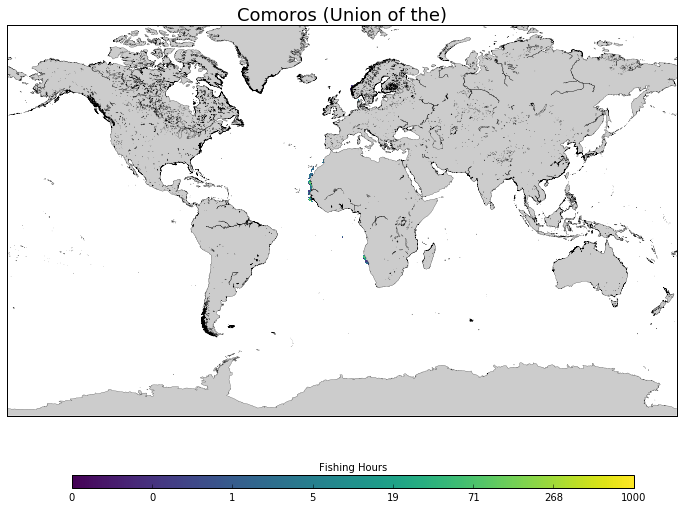

Iran (Islamic Republic of)


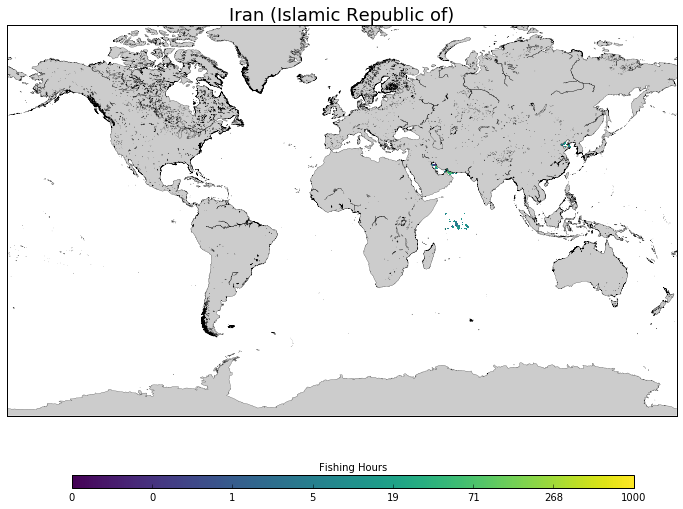

Bhutan (Kingdom of)


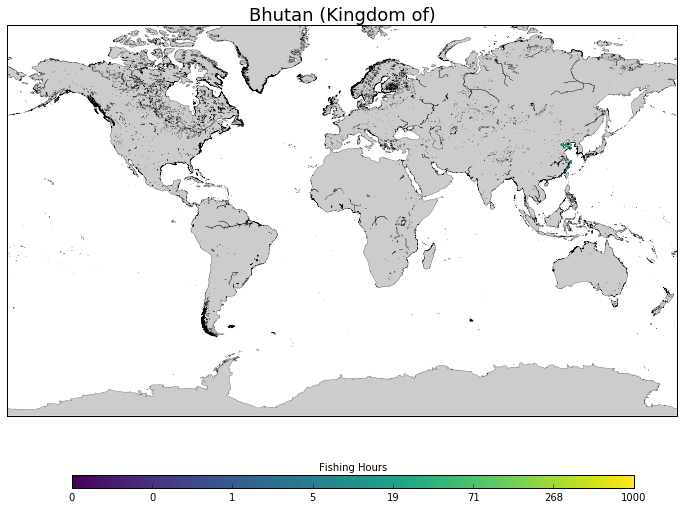

Macao (Special Administrative Region of China) - China (People's Republic of)


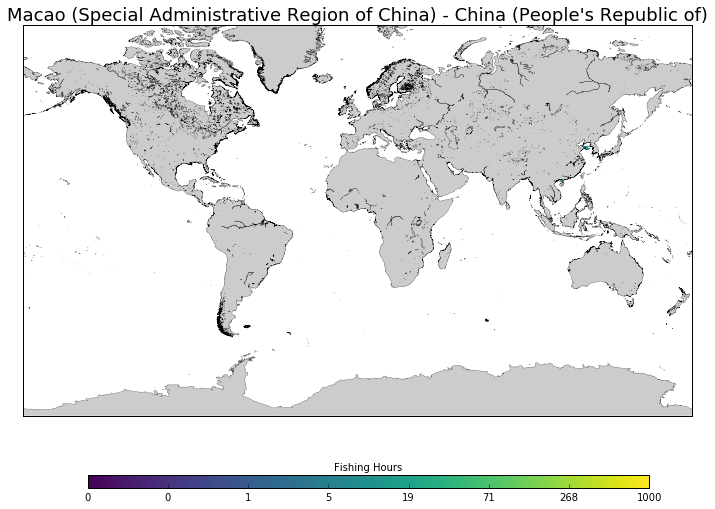

Iraq (Republic of)


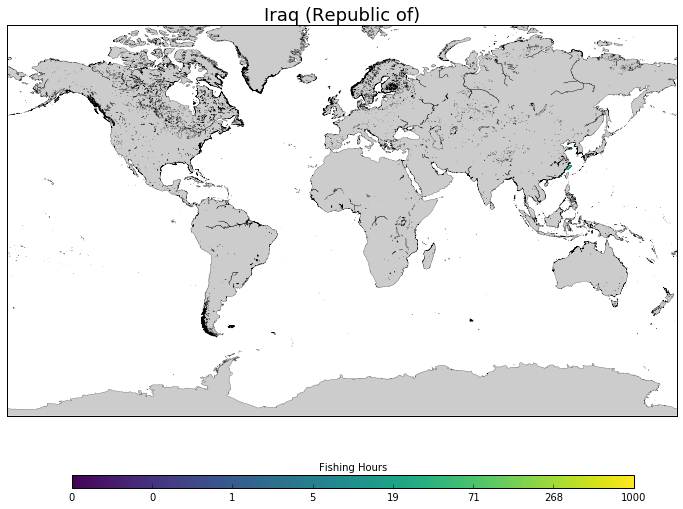

Saint Kitts and Nevis (Federation of)


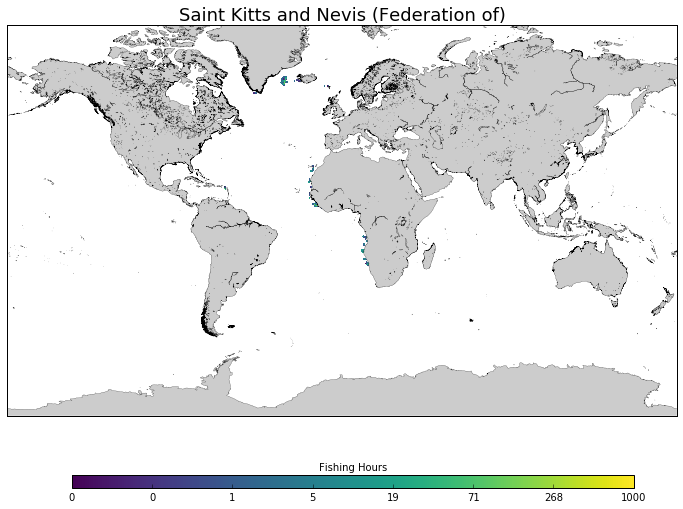

Mozambique (Republic of)


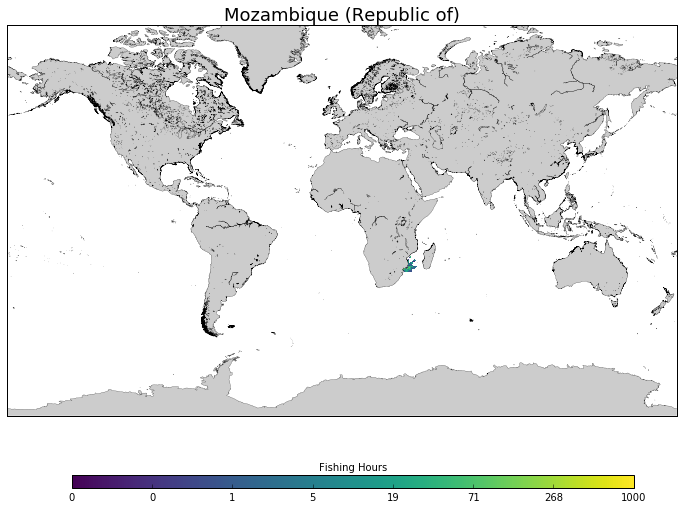

Somalia (Federal Republic of)


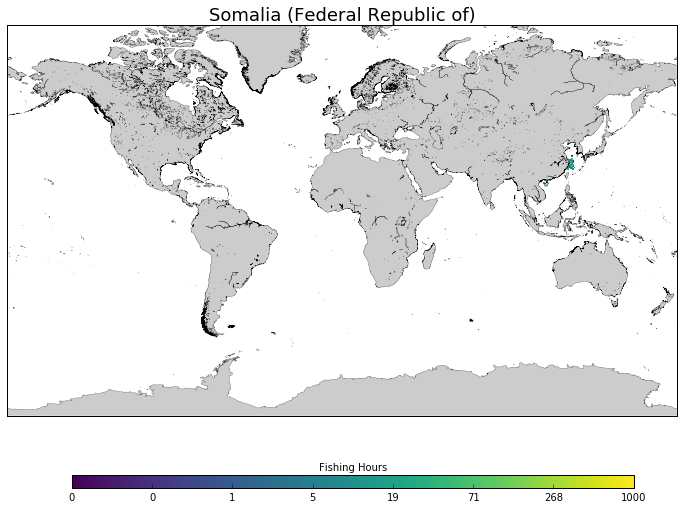

Crozet Archipelago - France


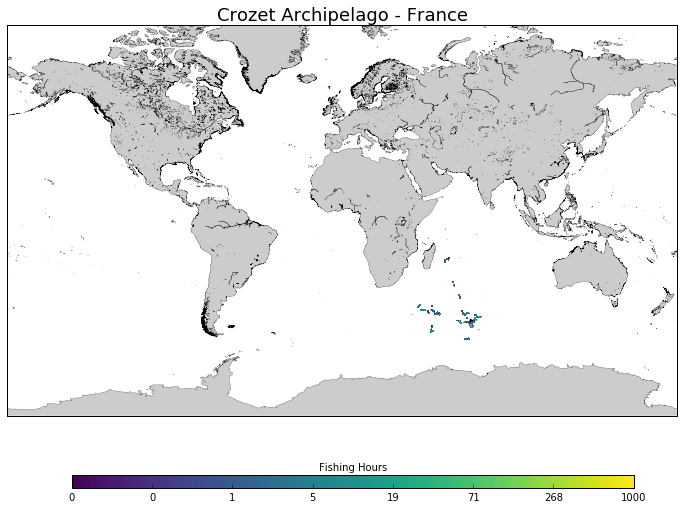

Mauritius (Republic of)


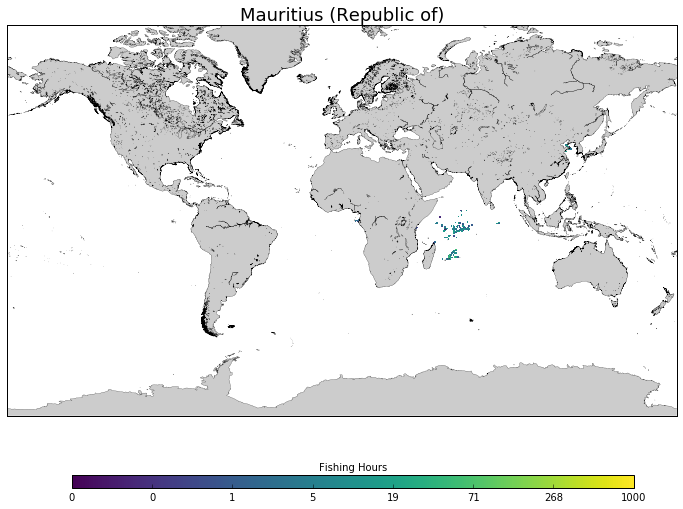

Maldives (Republic of)


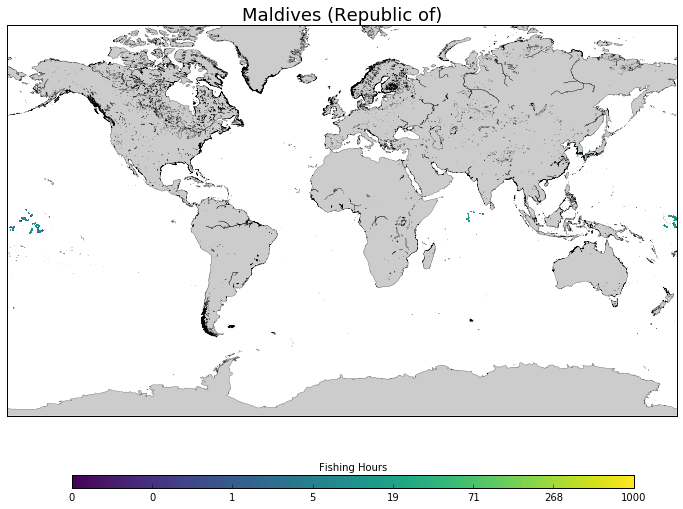

Saint Helena - United Kingdom of Great Britain and Northern Ireland


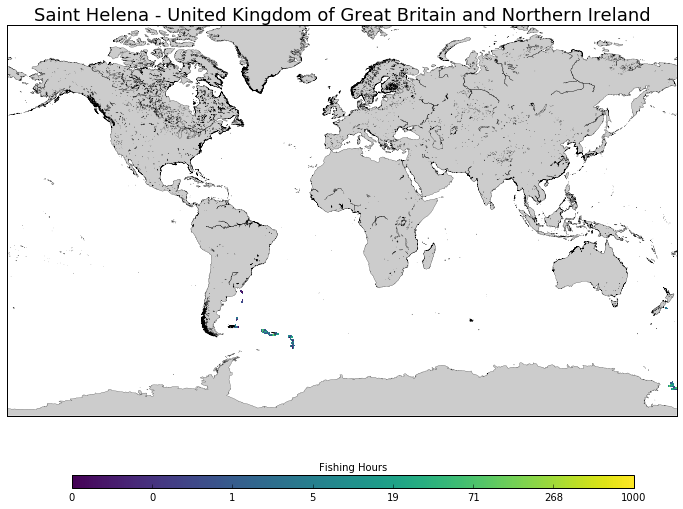

Cook Islands - New Zealand


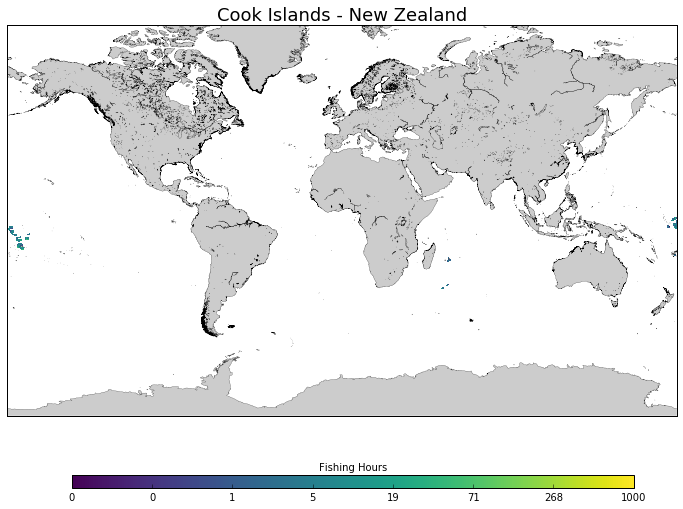

Sao Tome and Principe (Democratic Republic of)


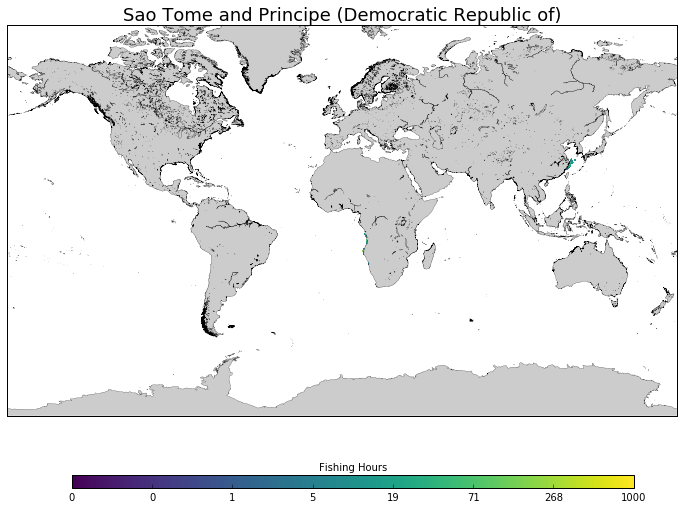

Saint Pierre and Miquelon (Territorial Collectivity of) - France


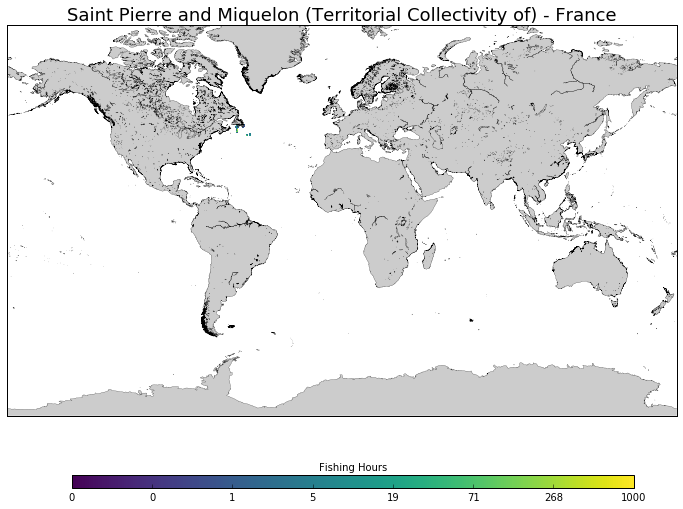

Solomon Islands


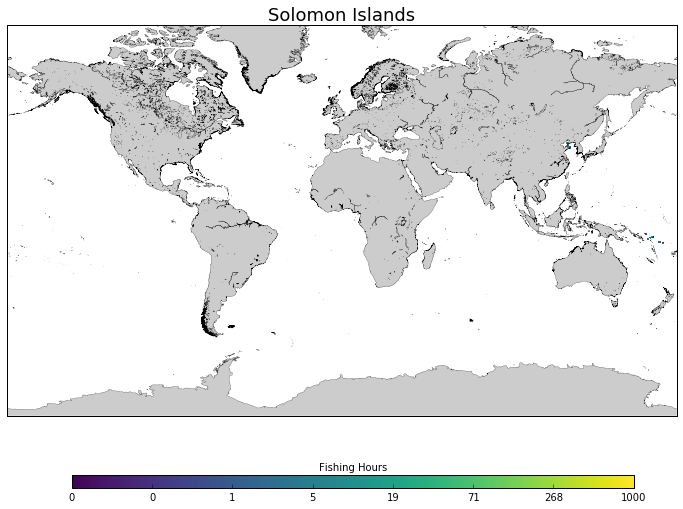

French Polynesia - France


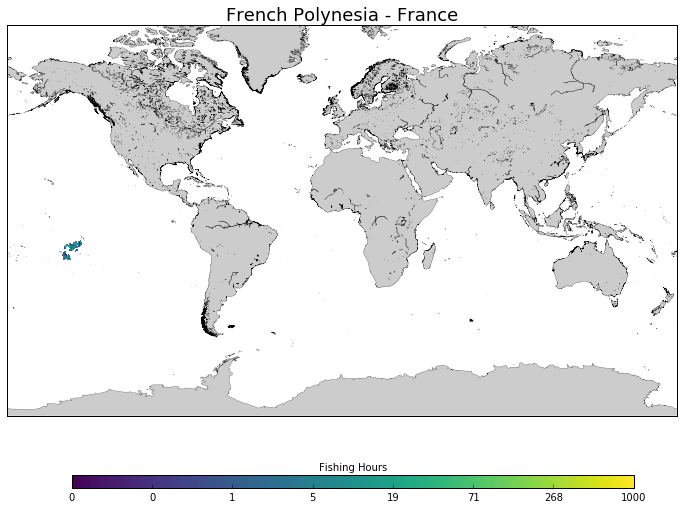

Afghanistan


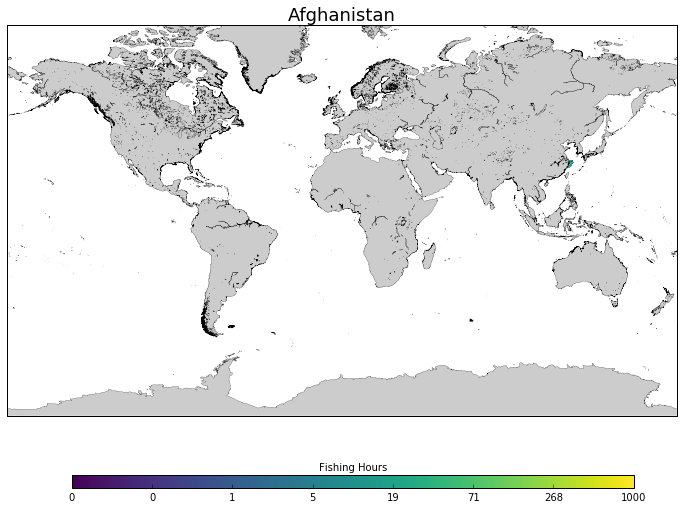

Dominica (Commonwealth of)


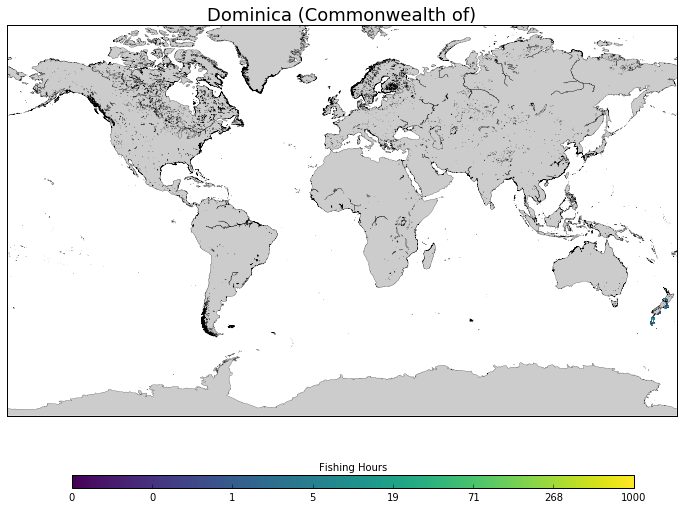

Cocos (Keeling) Islands - Australia


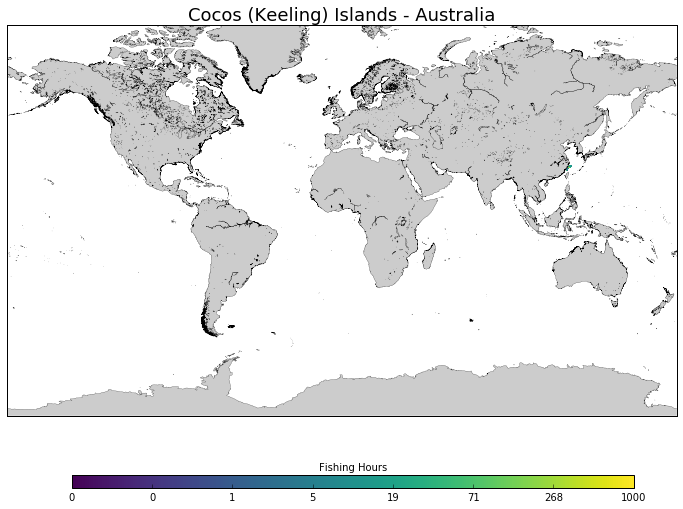

Anilles, Bonaire, Sint Eustatius and Saba - Netherlands (Kingdom of the)


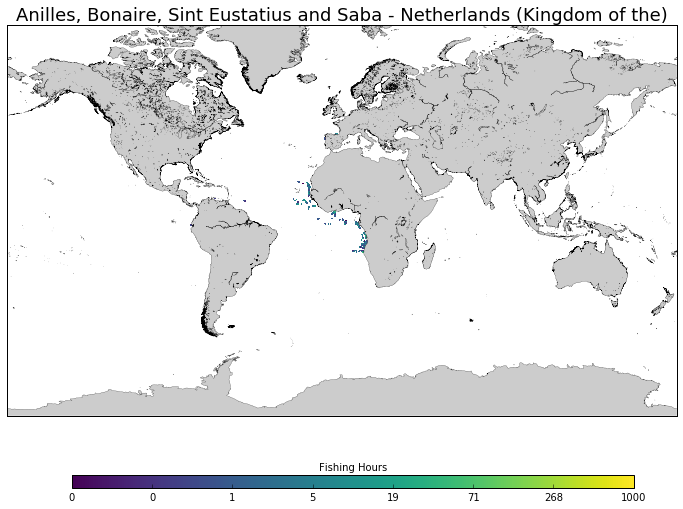

Slovenia (Republic of)


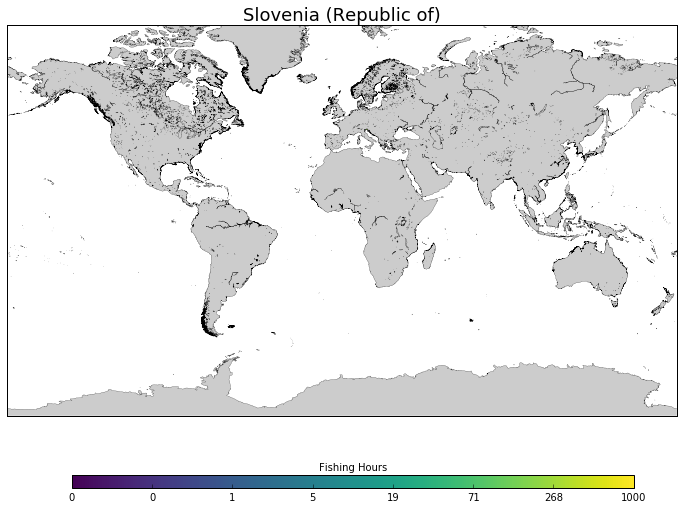

Martinique (French Department of) - France


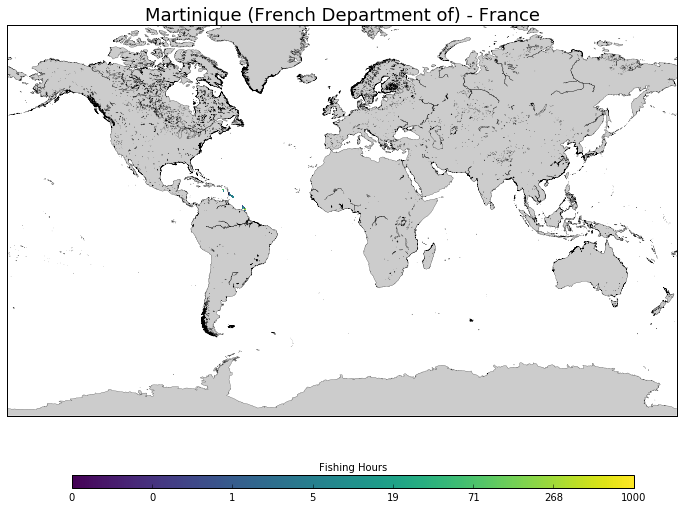

Indonesia (Republic of)


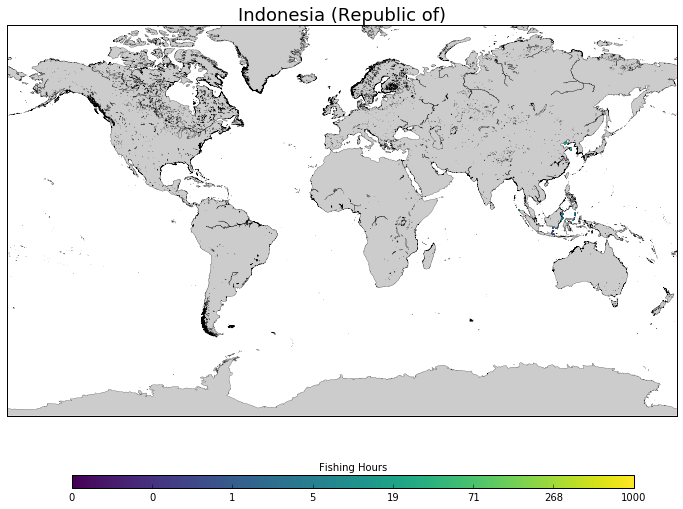

Cabo Verde (Republic of)


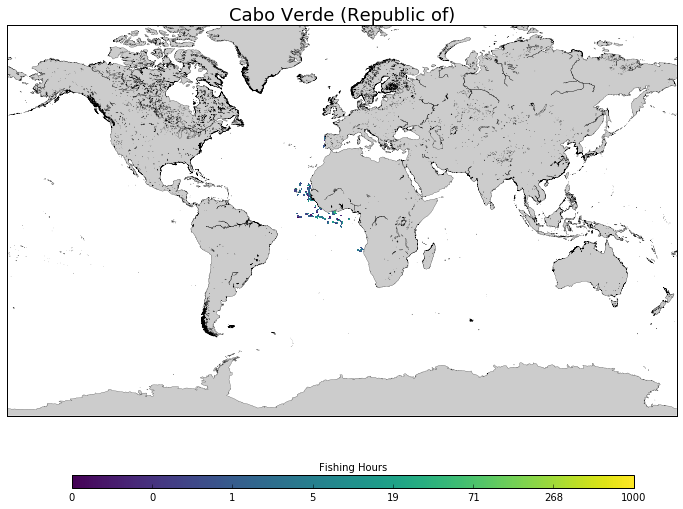

Viet Nam (Socialist Republic of)


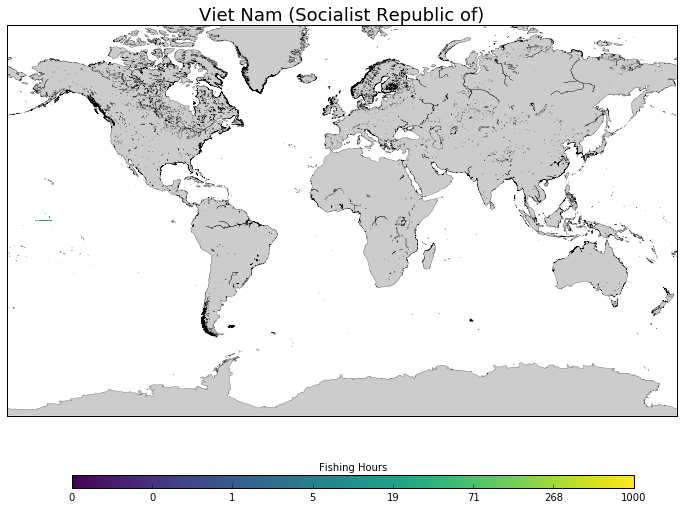

Sri Lanka (Democratic Socialist Republic of)


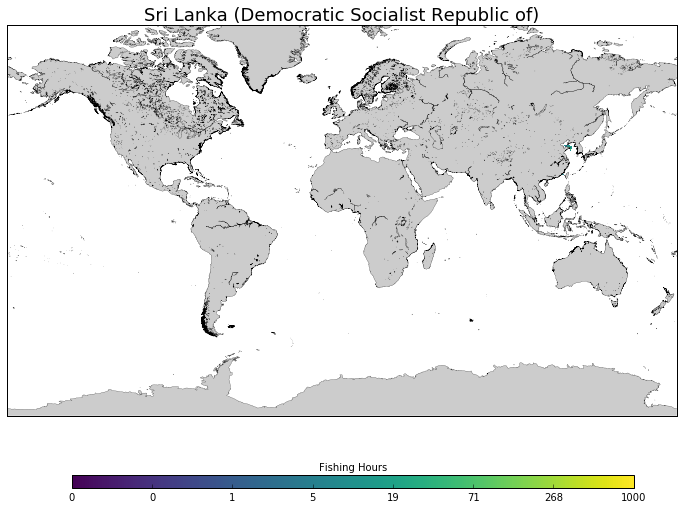

Tunisia


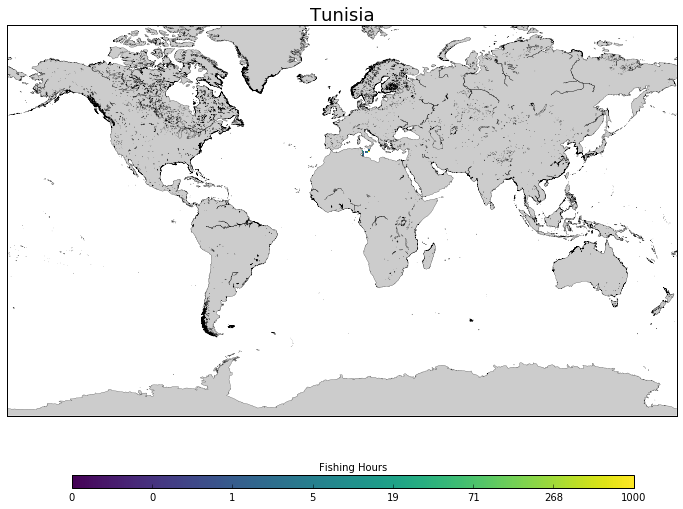

Guatemala (Republic of)


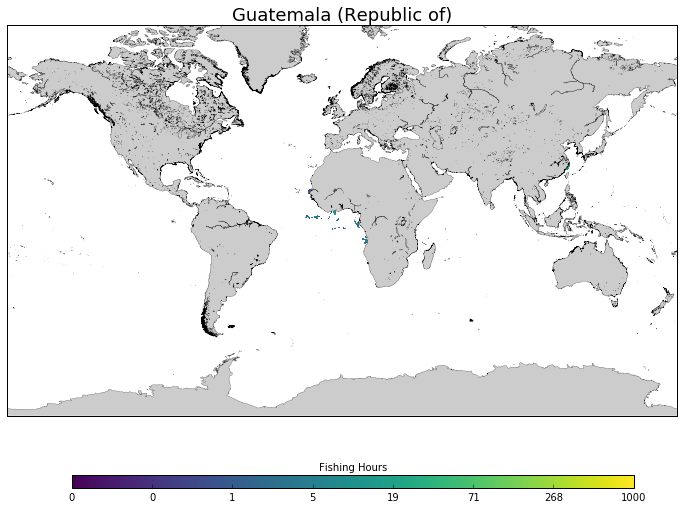

Romania


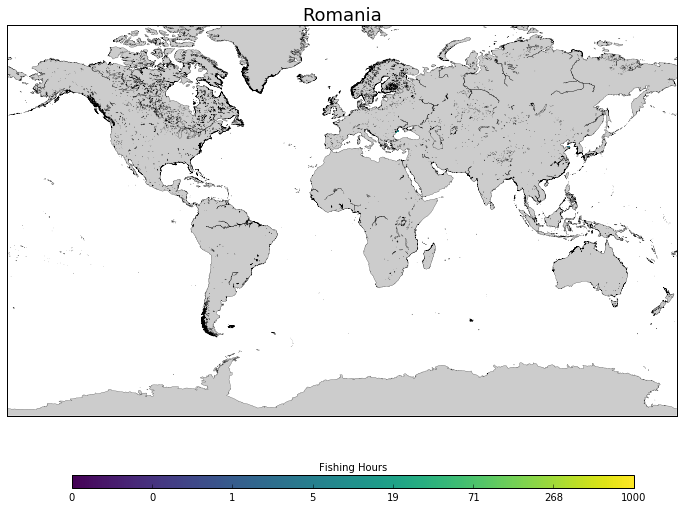

Liberia (Republic of)


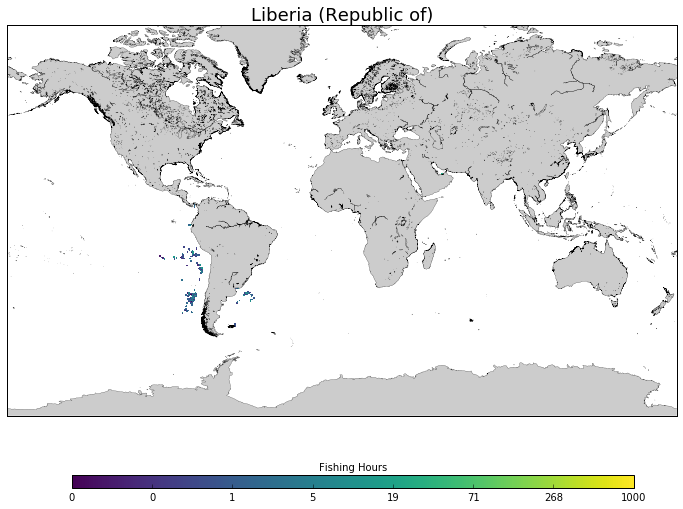

El Salvador (Republic of)


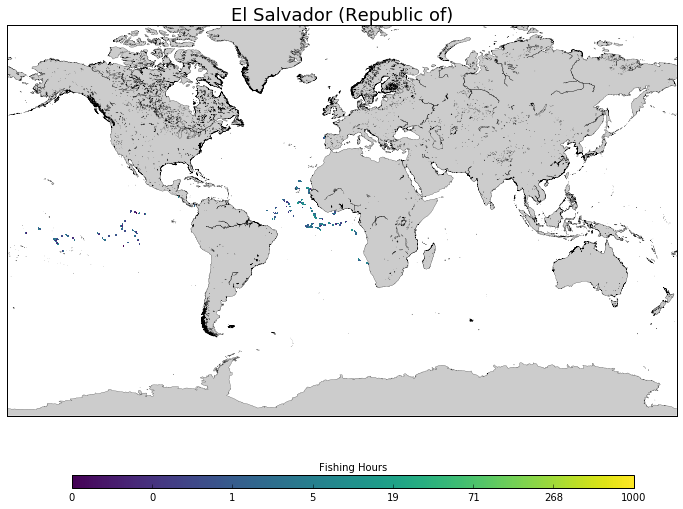

Tuvalu


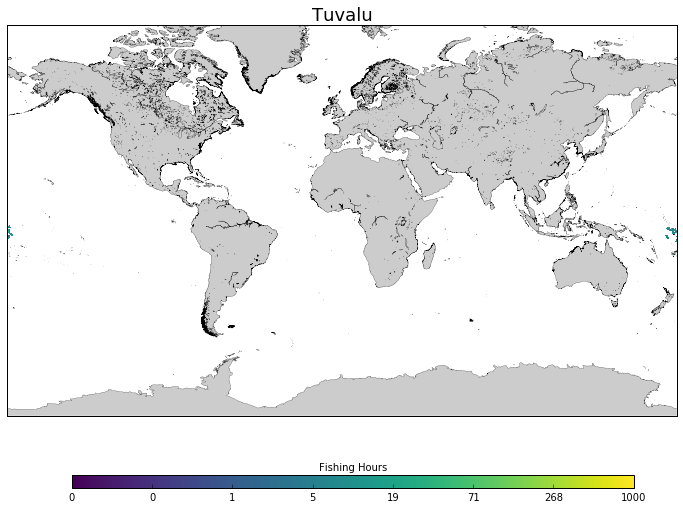

State of Palestine (In accordance with Resolution 99 Rev. Guadalajara, 2010)


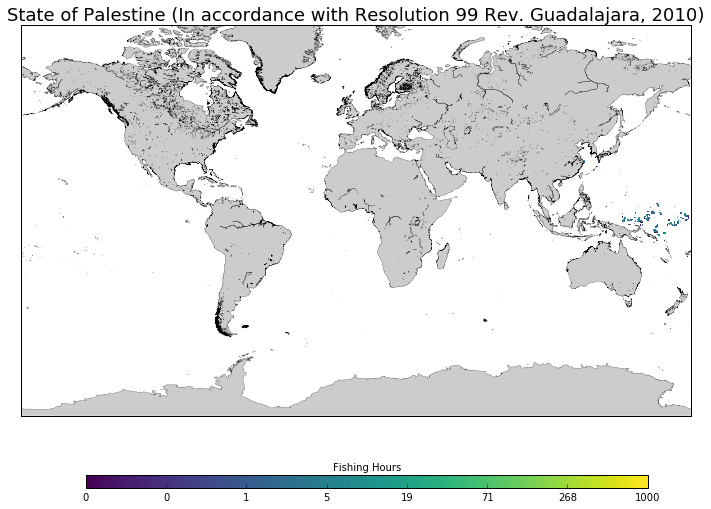

Libya


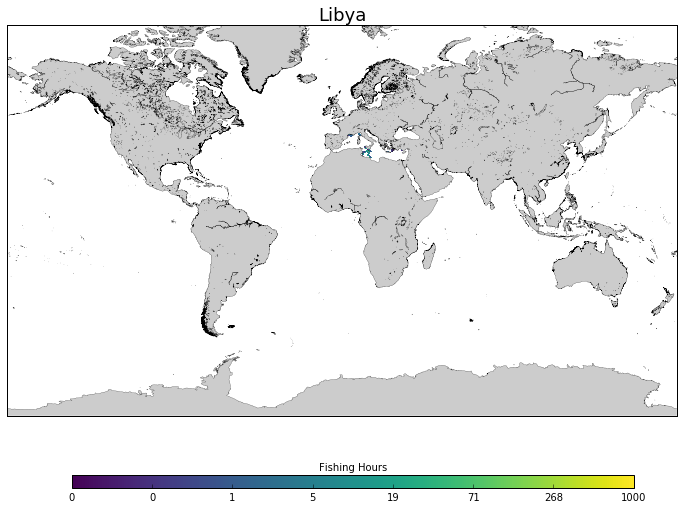

Burundi (Republic of)


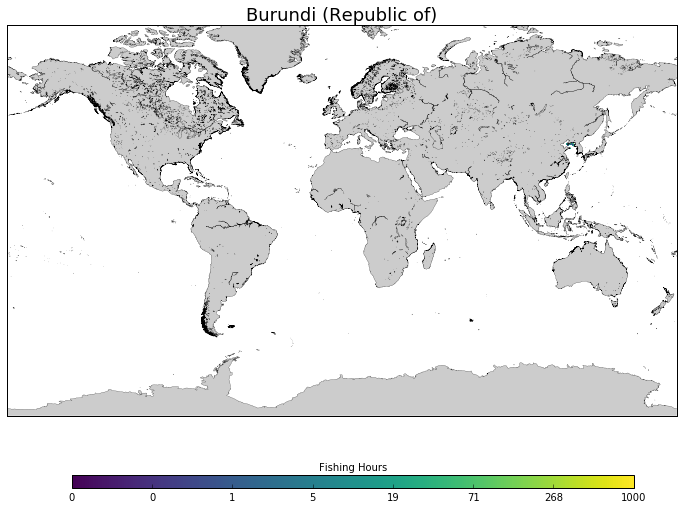

Costa Rica


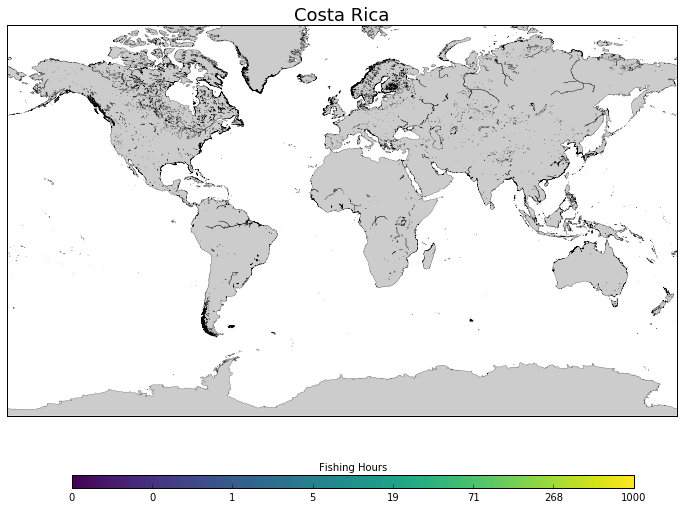

Pitcairn Island - United Kingdom of Great Britain and Northern Ireland


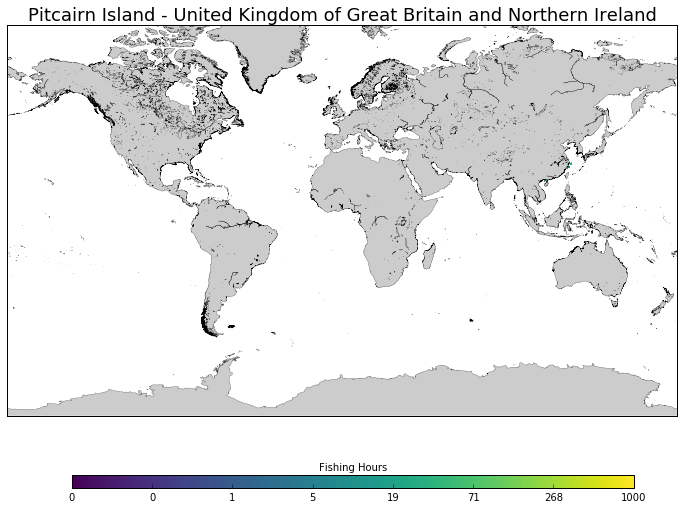

Grenada


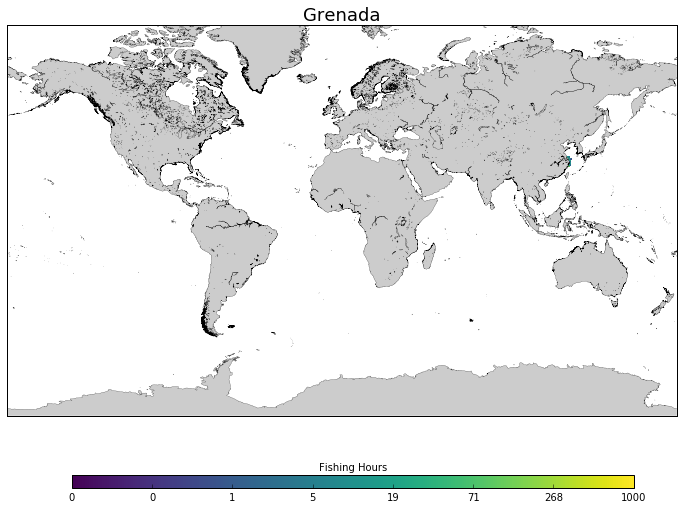

Oman (Sultanate of)


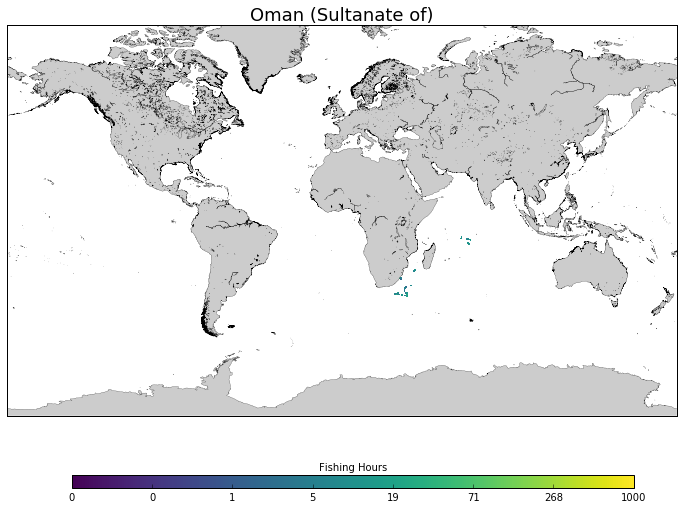

Nicaragua


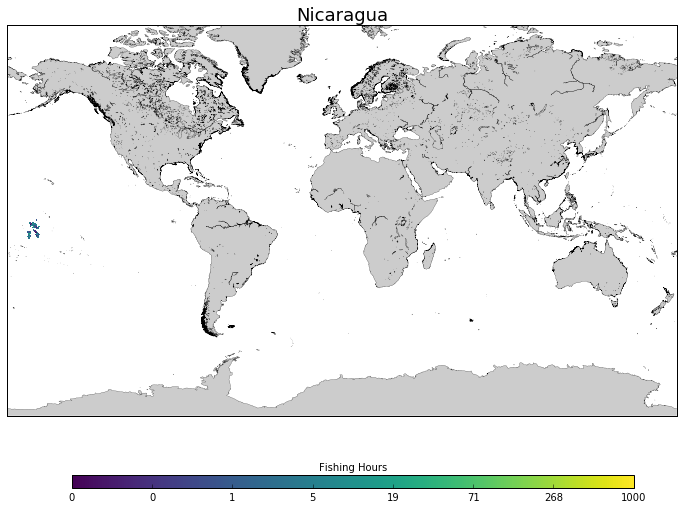

Cameroon (Republic of)


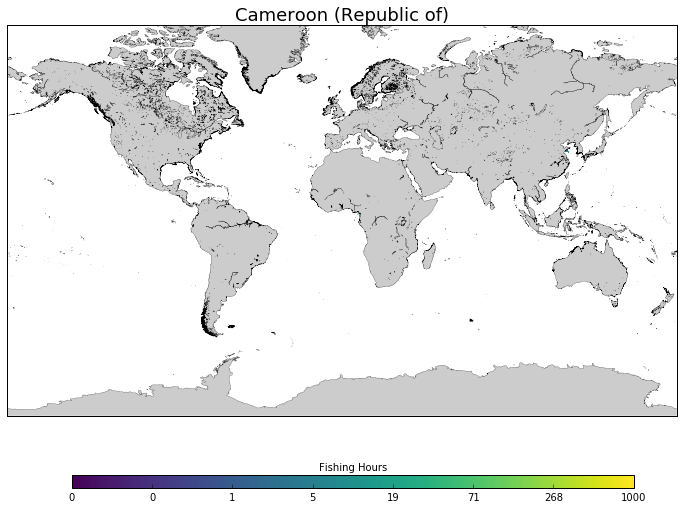

Sudan (Republic of the)


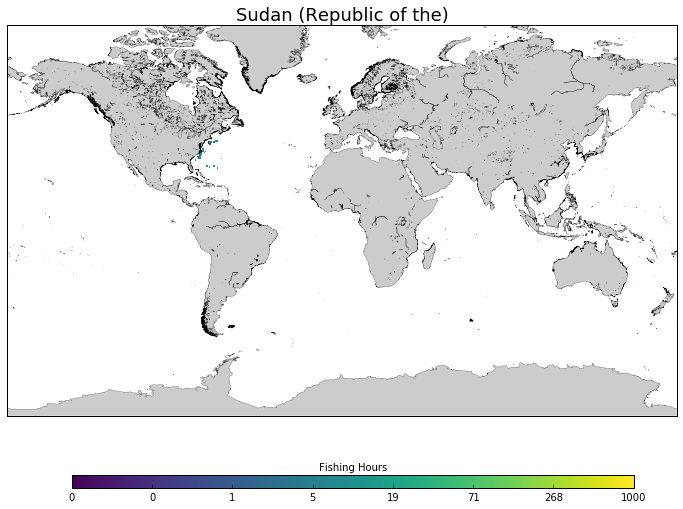

Moldova (Republic of)


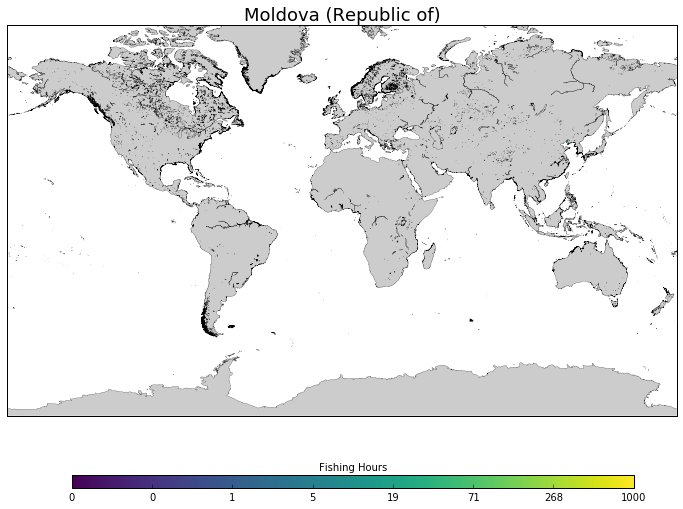

Bahrain (Kingdom of)


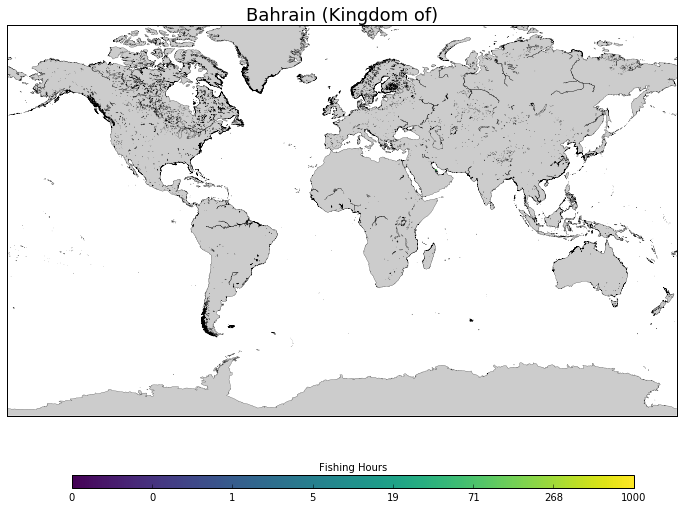

Anguilla - United Kingdom of Great Britain and Northern Ireland


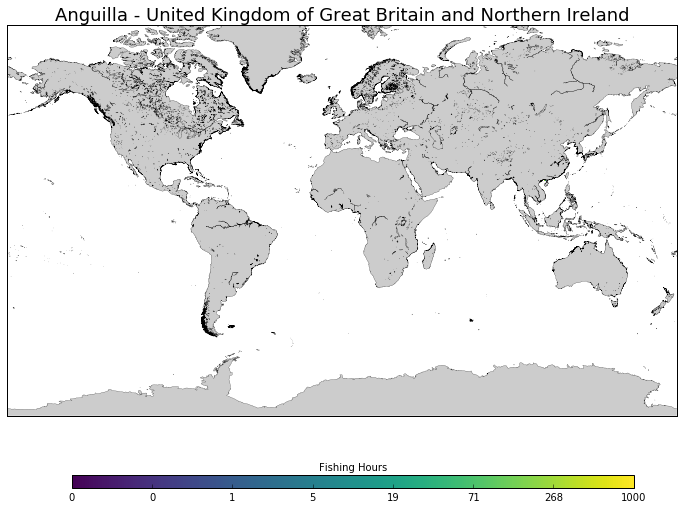

San Marino (Republic of)


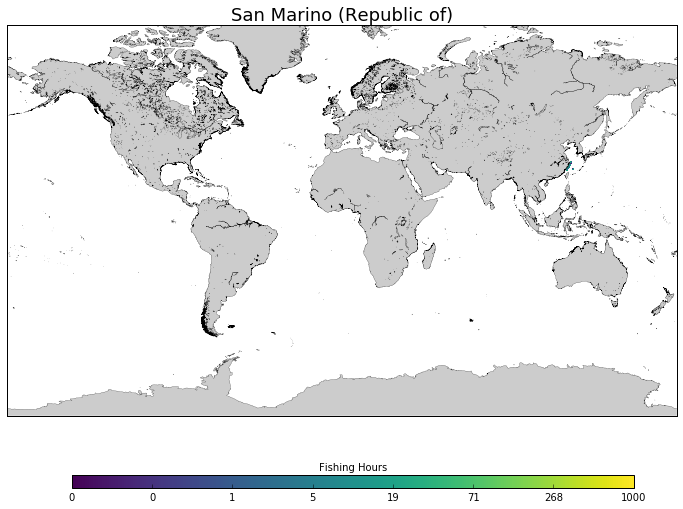

Tajikistan (Republic of)


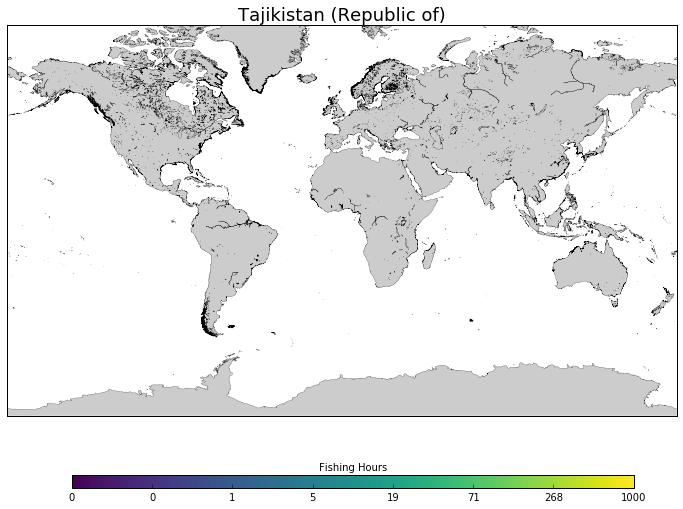

Sierra Leone


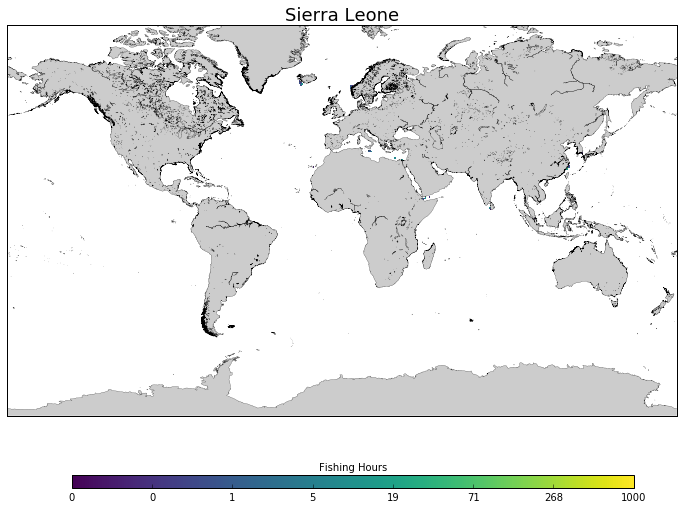

American Samoa - United States of America


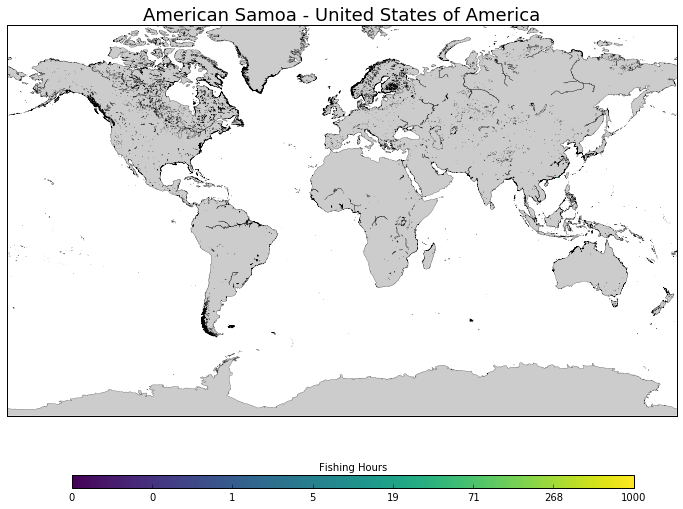

Monaco (Principality of)


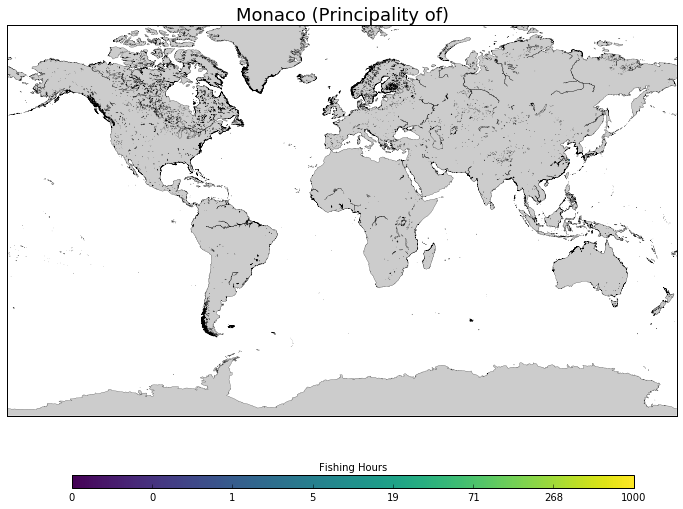

Cote d'Ivoire (Republic of)


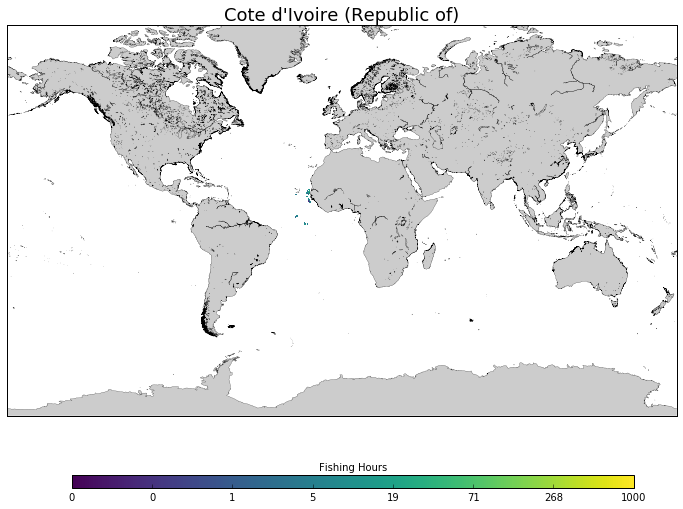

Georgia


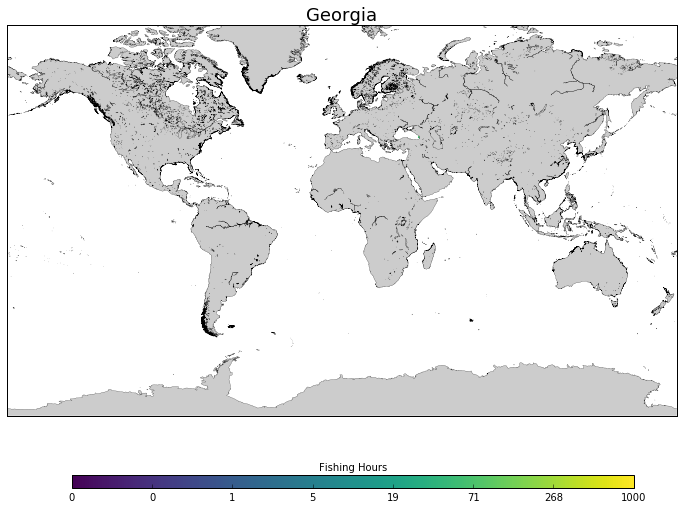

Suriname (Republic of)


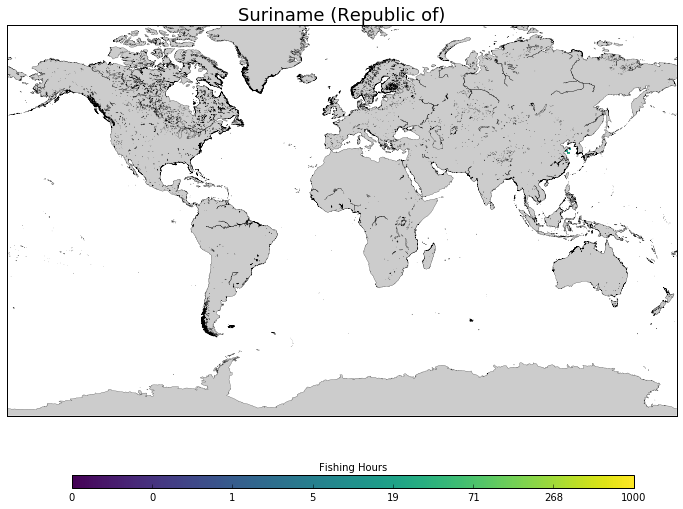

Guyana


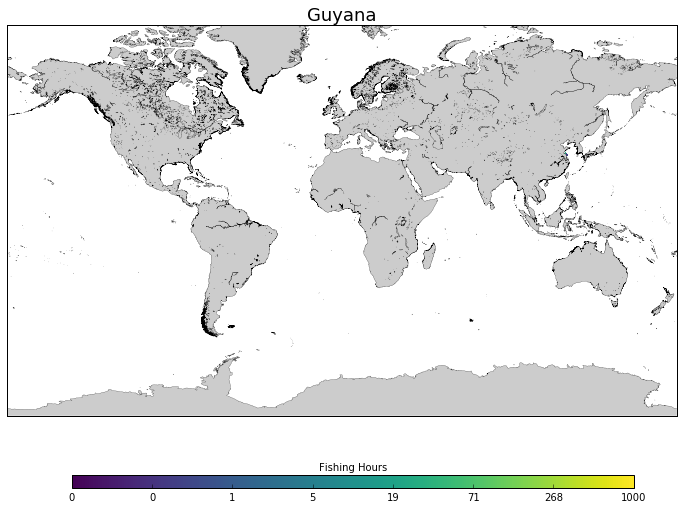

Tonga (Kingdom of)


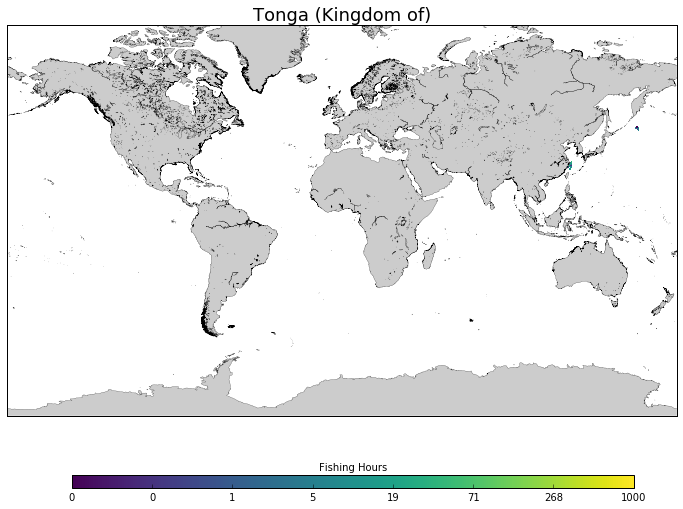

Barbados


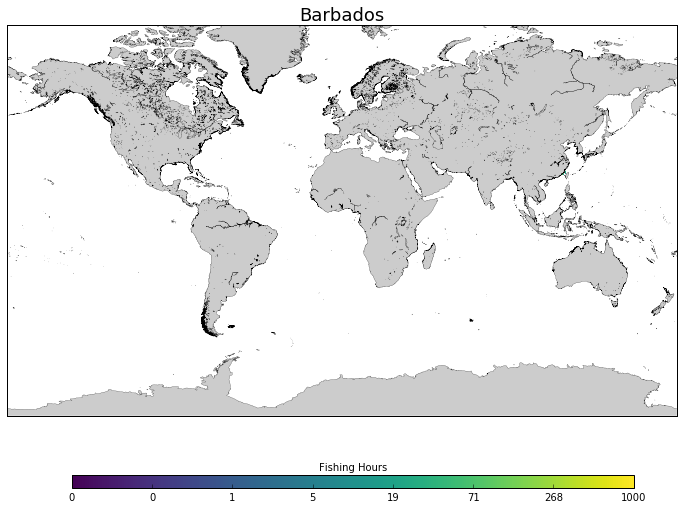

Mongolia


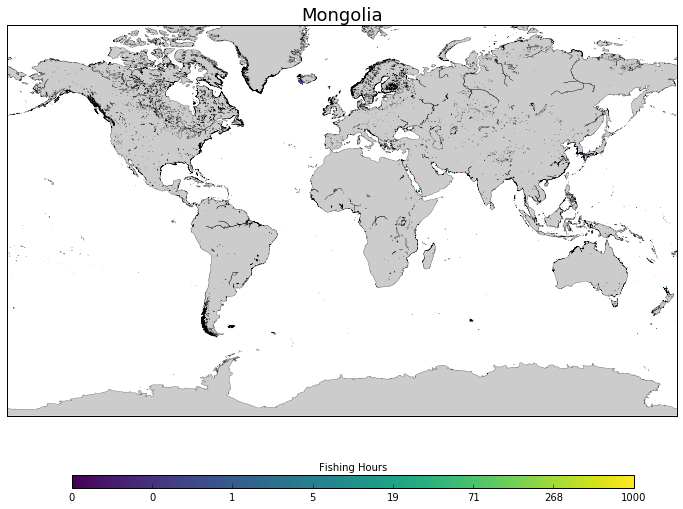

Slovak Republic


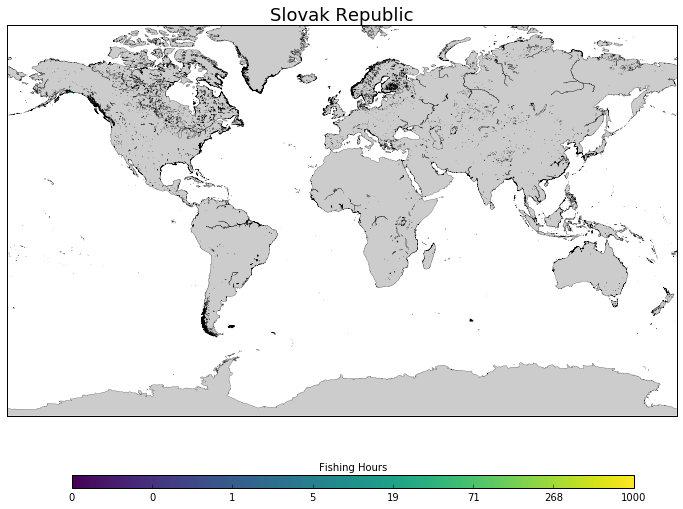

Central African Republic


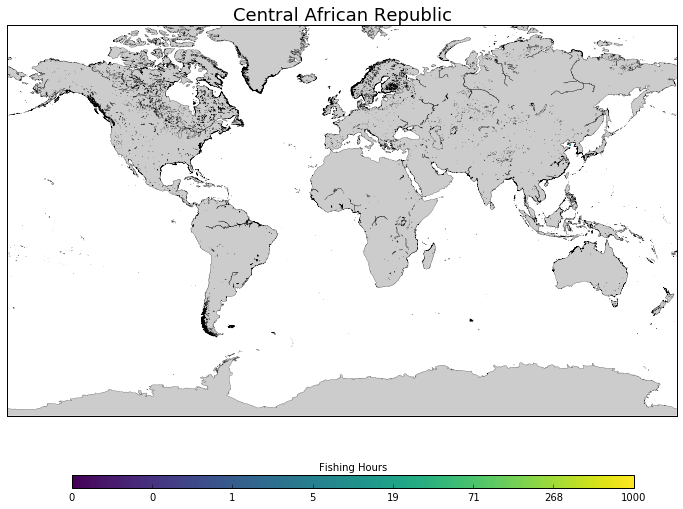

Trinidad and Tobago


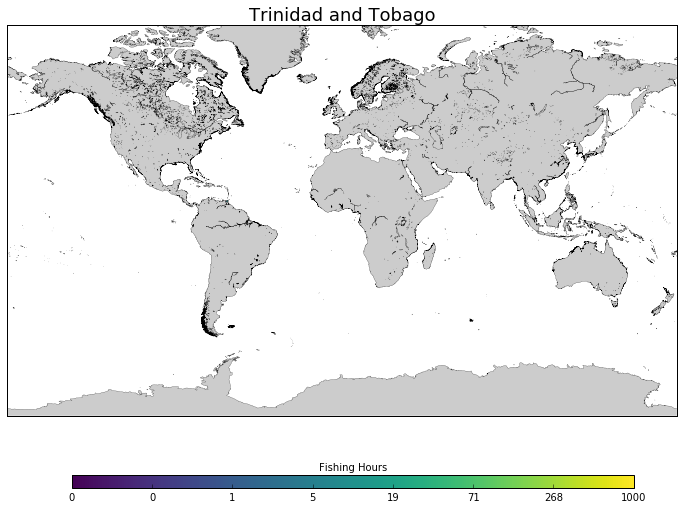

Rwanda (Republic of)


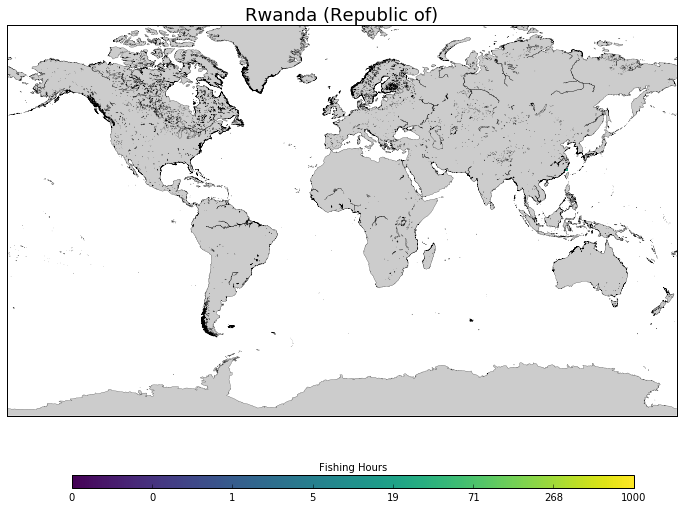

Algeria (People's Democratic Republic of)


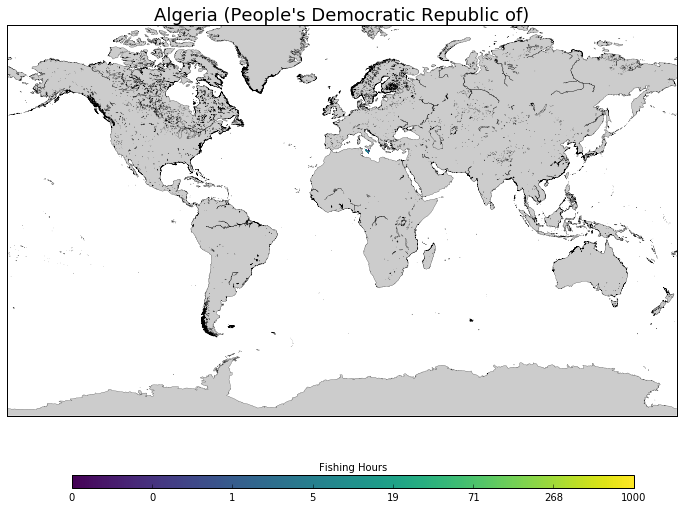

Brunei Darussalam


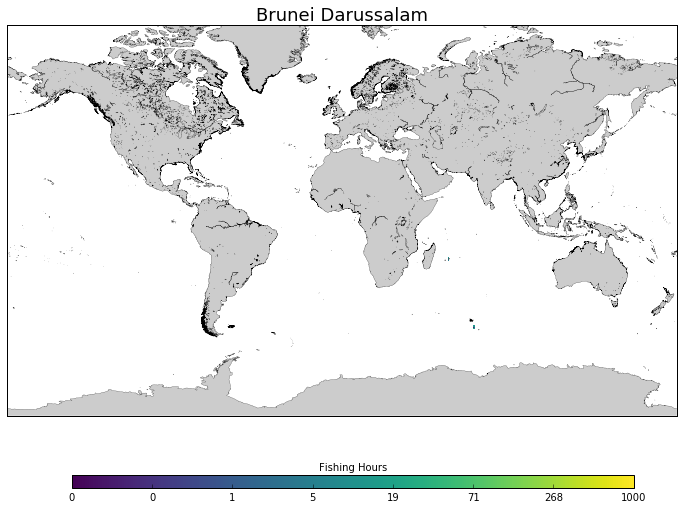

Jamaica


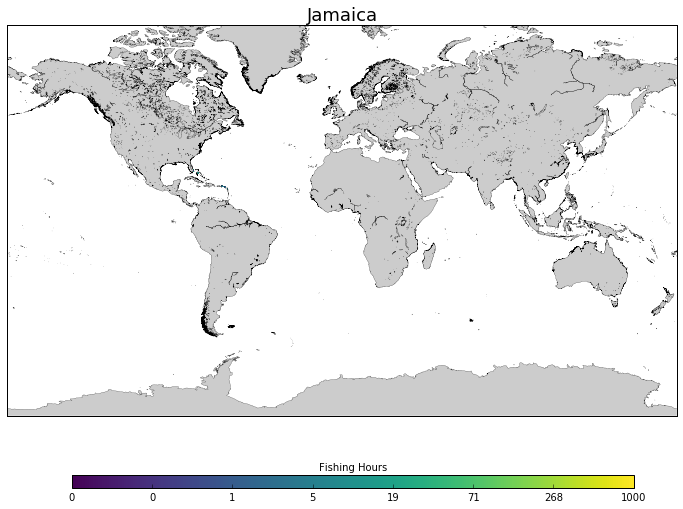

Democratic Republic of the Congo


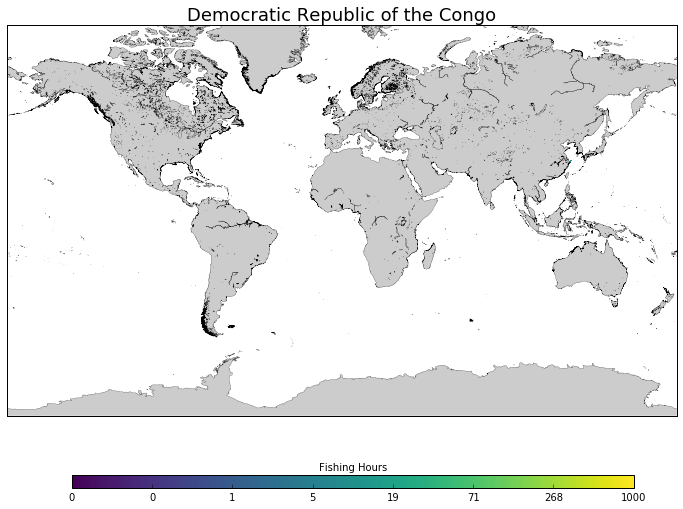

Tanzania (United Republic of)


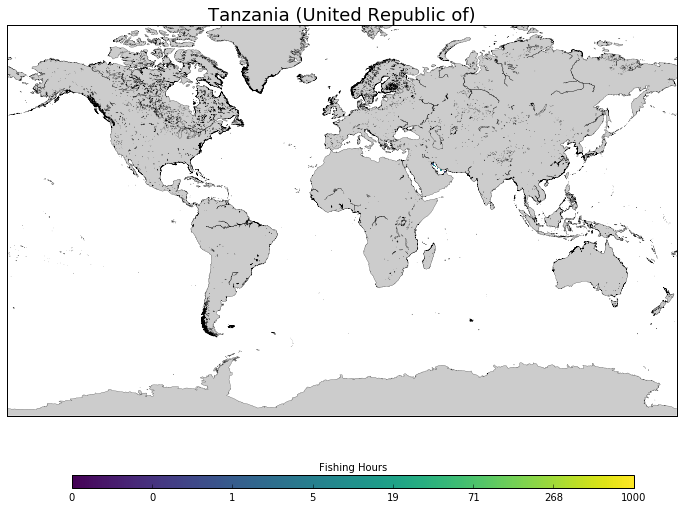

Dominican Republic


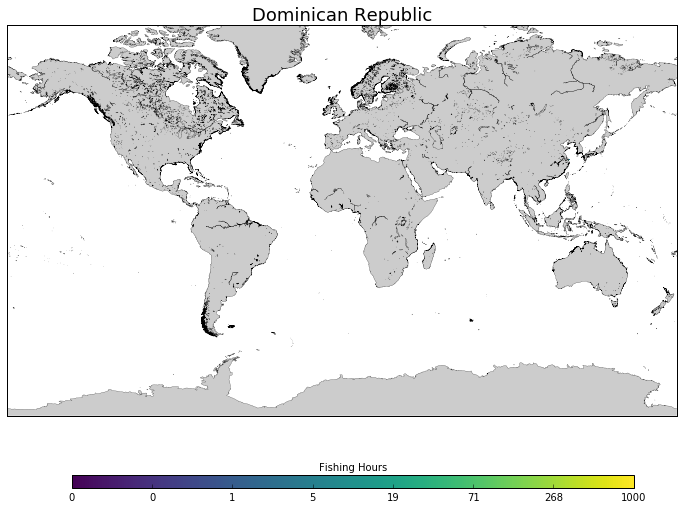

Singapore (Republic of)


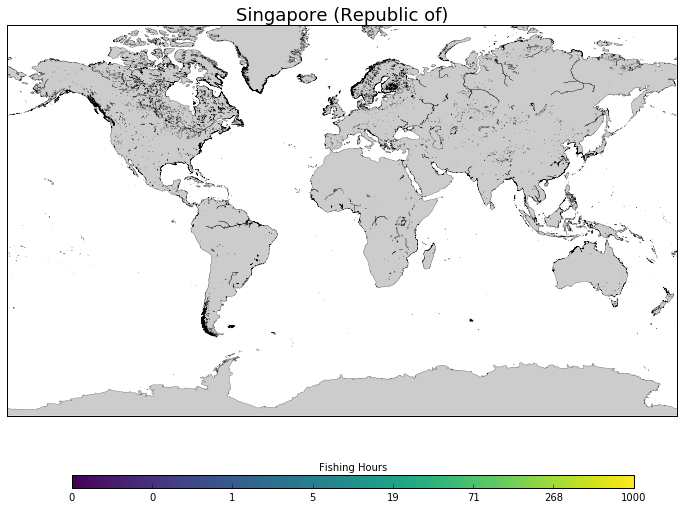

Kenya (Republic of)


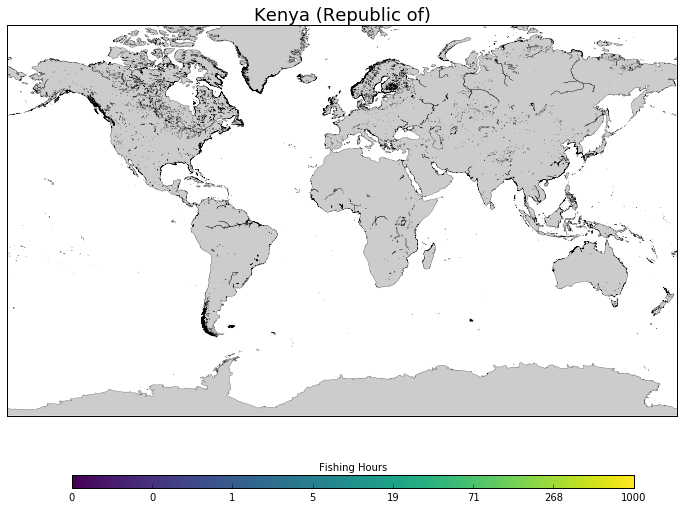

Cayman Islands - United Kingdom of Great Britain and Northern Ireland


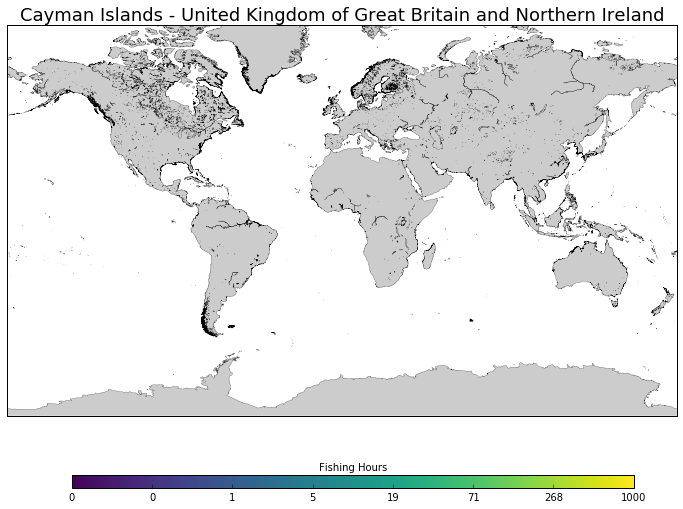

Angola (Republic of)


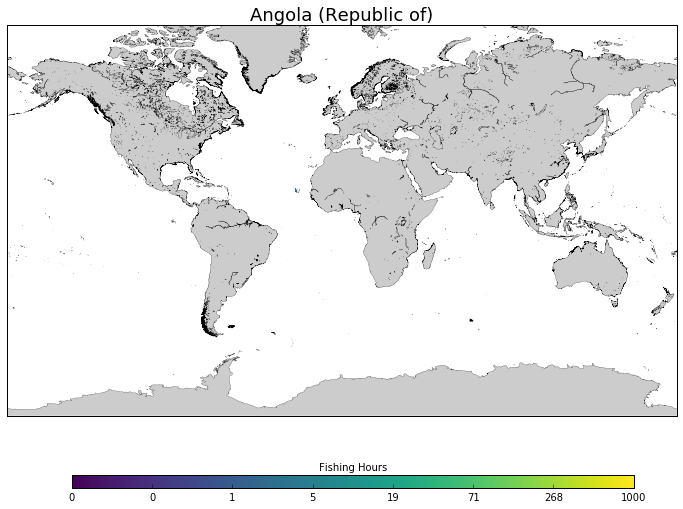

Cambodia (Kingdom of)


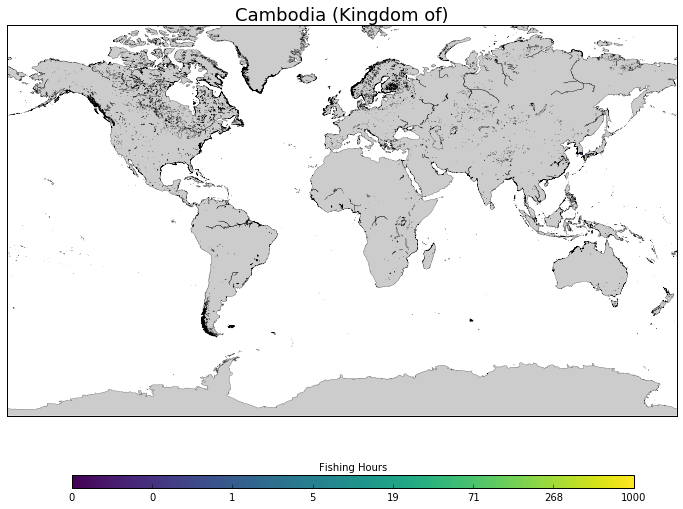

Guinea (Republic of)


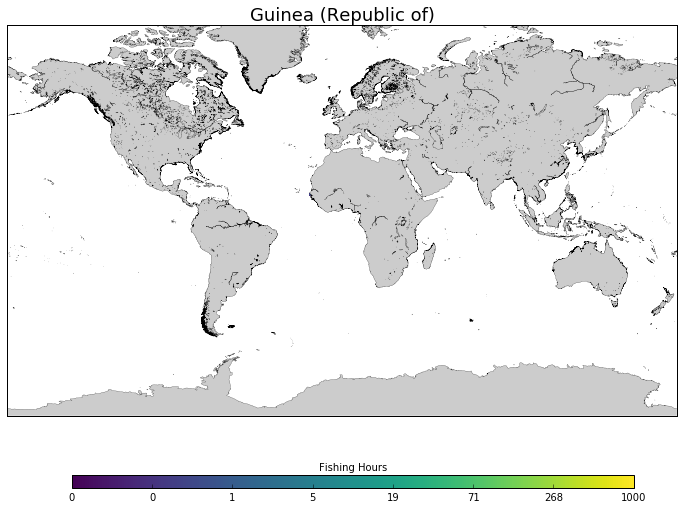

Swaziland (Kingdom of)


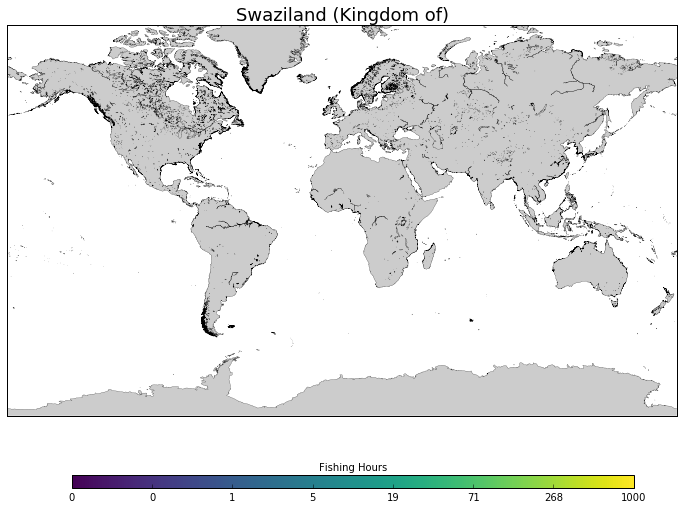

In [22]:
for c in country_groups:
    print c[0]
    grid = np.zeros(shape=(num_lats,num_lons))

    for row in bycountry:
        if row[3] == c[0]:
            lat = int(row[0])
            lon = int(row[1])
            lat_index = lat-min_lat*one_over_cellsize
            lon_index = lon-min_lon*one_over_cellsize
            grid[lat_index][lon_index] = float(row[2])
    
    makeMap(grid,c[0],1000)

In [ ]:
def makeMap2(grid,fig_title,fig_max_value):
    plt.rcParams["figure.figsize"] = [8,9]

    firstlat = max_lat
    lastlat =  min_lat
    firstlon = min_lon
    lastlon = max_lon
    scale = cellsize

    numlats = int((firstlat-lastlat)/scale+.5)
    numlons = int((lastlon-firstlon)/scale+.5)

    lat_boxes = np.linspace(lastlat,firstlat,num=numlats,endpoint=False)
    lon_boxes = np.linspace(firstlon,lastlon,num=numlons,endpoint=False)

    fig = plt.figure()
    extra = 0
    m = Basemap(llcrnrlat=lastlat-extra, urcrnrlat=firstlat+extra,
              llcrnrlon=firstlon-extra, urcrnrlon=lastlon+extra, lat_ts=0, projection='mill',resolution="h")

    m.drawmapboundary()#fill_color='#111111')
    m.drawcoastlines(linewidth=.2)
    m.fillcontinents('#cccccc',lake_color='#cccccc')#, lake_color, ax, zorder, alpha)

    x = np.linspace(firstlon, lastlon, -(firstlon-lastlon)*one_over_cellsize+1)
    y = np.linspace(lastlat, firstlat, (firstlat-lastlat)*one_over_cellsize+1)
    x, y = np.meshgrid(x, y)
    converted_x, converted_y = m(x, y)
    from matplotlib import colors,colorbar

    maximum = fig_max_value # grid.max()
    minimum = .1 #1

    norm = colors.LogNorm(vmin=minimum, vmax=maximum)
    # norm = colors.Normalize(vmin=0, vmax=1000)

    m.pcolormesh(converted_x, converted_y, grid, norm=norm, vmin=minimum, vmax=maximum, cmap = plt.get_cmap('viridis'))

    t = fig_title
    plt.title(t, color = "#000000", fontsize=18)

    ax = fig.add_axes([0.2, 0.1, 0.65, 0.02]) #x coordinate , 
    norm = colors.LogNorm(vmin=minimum, vmax=maximum)
    # norm = colors.Normalize(vmin=0, vmax=1000)
    lvls = np.logspace(np.log10(minimum),np.log10(maximum),num=8)
    cb = colorbar.ColorbarBase(ax,norm = norm, orientation='horizontal', ticks=lvls, cmap = plt.get_cmap('viridis'))

    #cb.ax.set_xticklabels(["0" ,round(m3**.5,1), m3, round(m3**1.5,1), m3*m3,round(m3**2.5,1), str(round(m3**3,1))+"+"], fontsize=10)
    cb.ax.set_xticklabels([int(i) for i in lvls], fontsize=10, color = "#000000")
    cb.set_label('Fishing Hours',labelpad=-40, y=0.45, color = "#000000")
    # plt.savefig("fishing_effort_mascarene.png",bbox_inches='tight',dpi=300,transparent=True,pad_inches=.1)
    plt.show()